In [592]:
#Welcome to our code! This notebook primarily handles the longitudinal school disciplinary and demographic data. It also handles chloropleths and analysis of the data

In [ ]:
#DATA COLLECTION

In [152]:
import pandas as pd

#reading in discipline data for all us
df = pd.read_csv("CDP03.2_105_USSchoolDistrictAll_525101759286.txt", delimiter="|")

In [153]:
cols = pd.read_excel("ACS-ED_2018-2022_RecordLayouts.xlsx", sheet_name="CDP_ChildPop")
cols
#creating a dict to fix column names. as the current columns are just school codes.
names = {}
for name in cols["varname"]:
    names[name] = cols.loc[cols["varname"] == name, "vlabel"].values[0]



In [154]:
df = df.rename(columns=names)
df = df.rename(columns = {"Number; Estimate; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Total households" : "Total Households",
                         "Number; Estimate; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Total households; Less than $10,000" : "Total Households Less than $10,000"},
                          )
df

,GeoId,Geography,LEAID,Year,Iteration,Total Households,Number; Margin of Error; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Total households,"Total Households Less than $10,000","Number; Margin of Error; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Total households; Less than $10,000","Percent; Estimate; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Total households; Less than $10,000",...,"Percent; Estimate; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; $150,000 to $199,999","Percent; Margin of Error; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; $150,000 to $199,999","Number; Estimate; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; $200,000 or more","Number; Margin of Error; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; $200,000 or more","Percent; Estimate; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; $200,000 or more","Percent; Margin of Error; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; $200,000 or more",Number; Estimate; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; Median family income (dollars),Number; Margin of Error; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; Median family income (dollars),Number; Estimate; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; Mean family income (dollars),Number; Margin of Error; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; Mean family income (dollars)
0,9700000US0200050,"Alaska Gateway School District, AK",200050,2018-2022,105,120,44,10,14,8.3,...,3.3,7.3,10,13,8.3,10.7,73333,30062,92433,28437
1,9700000US0200007,"Aleutians East Borough School District, AK",200007,2018-2022,105,215,43,15,10,7.0,...,14.0,6.8,4,4,1.9,2.5,67917,29543,72699,10492
2,9700000US0200180,"Anchorage School District, AK",200180,2018-2022,105,23970,1144,260,116,1.1,...,14.8,2.0,4435,539,18.6,2.0,107401,7385,135328,5277
3,9700000US0200525,"Annette Island School District, AK",200525,2018-2022,105,165,40,4,7,2.4,...,9.1,11.4,4,7,2.4,4.5,92292,40416,95627,16125
4,9700000US0200020,"Bering Strait School District, AK",200020,2018-2022,105,935,71,35,15,3.7,...,3.8,1.7,55,25,5.9,2.6,54286,5233,70823,6186
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11367,9700000US5602760,"Uinta County School District 1, WY",5602760,2018-2022,105,1225,220,4,2,0.3,...,12.1,7.8,15,19,1.3,1.7,79042,8595,88154,10281
11368,9700000US5604500,"Uinta County School District 4, WY",5604500,2018-2022,105,320,125,0,13,NaN,...,20.3,16.9,70,51,21.9,15.4,135625,46433,148833,29293
11369,9700000US5604260,"Uinta County School District 6, WY",5604260,2018-2022,105,280,111,0,13,NaN,...,14.3,12.3,50,47,17.9,15.7,127500,23643,126523,39635
11370,9700000US5606240,"Washakie County School District 1, WY",5606240,2018-2022,105,605,129,0,18,NaN,...,6.6,5.7,45,40,7.4,6.4,86250,31496,94532,11754


In [155]:
print(repr('CDP03_6moe' in names.keys()))

True


In [156]:

df.columns
#this dataset is EXTREMELY large and data isnt very clean or specific. At this point, we made the choice to focus on Chicago

Index(['GeoId', 'Geography', 'LEAID', 'Year', 'Iteration', 'Total Households',
       'Number; Margin of Error; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Total households',
       'Total Households Less than $10,000',
       'Number; Margin of Error; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Total households; Less than $10,000',
       'Percent; Estimate; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Total households; Less than $10,000',
       ...
       'Percent; Estimate; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; $150,000 to $199,999',
       'Percent; Margin of Error; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; $150,000 to $199,999',
       'Number; Estimate; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; $200,000 or more',
       'Number; Margin of Error; INCOME AND BENEFITS (IN 2022 INFLATION-ADJUSTED DOLLARS); Families; $200,000 or more',
       'Percent; Estimate; 

In [157]:
disc_df = pd.read_excel("chicago_punitive_measures.xlsx", sheet_name="School Level Data")
disc_df

,School ID,School Name,School Network,School Year,Time Period,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),...,Average Length of ISS,# of OSS,% of Misconducts Resulting in an OSS,# of Unique Students Receiving OSS,% of Unique Students Receiving OSS,Average Length of OSS,# of Police Notifications,% of Misconducts Resulting in a Police Notification,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification
0,400153,ACERO - BRIGHTON PARK,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,400149,ACERO - SOTO HS,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,609772,ADDAMS,Network 13,2023-2024,EOY,77,58,18,1,2,...,NaN,2,2.6,2,0.4,1,NaN,NaN,NaN,NaN
3,610513,AIR FORCE HS,Network 16,2023-2024,EOY,123,62,59,2,38,...,1.1,8,6.5,8,7.1,1.38,3,2.4,3,2.7
4,610212,ALBANY PARK,Network 1,2023-2024,EOY,46,23,18,5,9,...,1,3,6.5,3,1.3,1.33,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11255,610380,"WILLIAMS, D",Network 9,2013-2014,S1,92,13,73,6,80,...,1.67,62,67.4,42,14.4,3.1,36,39.1,24,8.2
11256,609977,WOODLAWN,Network 9,2013-2014,S1,14,6,6,2,13,...,0,13,92.9,9,4,1.46,0,0,0,0
11257,610345,WOODSON,Network 9,2013-2014,S1,121,3,103,15,118,...,1,117,96.7,68,17.8,2.09,2,1.7,2,0.5
11258,610392,WORLD LANGUAGE HS,Network 7,2013-2014,S1,50,31,19,0,28,...,1,19,38,18,5.2,2.26,0,0,0,0


In [158]:
disc_df["# of Misconducts"] = disc_df["# of Misconducts"].replace("--", 0).infer_objects(copy=False)
disc_df["# of Misconducts"] = disc_df["# of Misconducts"].astype(float)
disc_df.groupby("School Network")["# of Misconducts"].mean()
charter_df = disc_df[disc_df["School Network"] == "Charter"]
charter_df #oh no. it seems that charter schools do not report any disciplinary data :(

/var/folders/cx/zsfmy4rn4pn0py5ff6twjqf40000gn/T/ipykernel_3870/558459627.py:2: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  disc_df["# of Misconducts"] = disc_df["# of Misconducts"].replace("--", 0).infer_objects(copy=False)


,School ID,School Name,School Network,School Year,Time Period,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),...,Average Length of ISS,# of OSS,% of Misconducts Resulting in an OSS,# of Unique Students Receiving OSS,% of Unique Students Receiving OSS,Average Length of OSS,# of Police Notifications,% of Misconducts Resulting in a Police Notification,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification
0,400153,ACERO - BRIGHTON PARK,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,400149,ACERO - SOTO HS,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
89,400032,CICS - ELLISON HS,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
192,400168,GREAT LAKES,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
236,400104,INSTITUTO - HEALTH,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11223,400077,UNIV OF CHGO CHTR-WOODLAWN,Charter,2013-2014,S1,0.0,--,--,--,--,...,--,--,--,--,--,--,--,--,--,--
11224,400085,UNO CHTR - MAJOR HECTOR P.GARCIA,Charter,2013-2014,S1,0.0,--,--,--,--,...,--,--,--,--,--,--,--,--,--,--
11226,400105,URBAN PREP CHTR - BRONZEVILLE,Charter,2013-2014,S1,0.0,--,--,--,--,...,--,--,--,--,--,--,--,--,--,--
11227,400102,URBAN PREP CHTR - WEST,Charter,2013-2014,S1,0.0,--,--,--,--,...,--,--,--,--,--,--,--,--,--,--


In [159]:
fin_dfs = {}  # Dictionary to hold all DataFrames

for year in range(2014, 2017):
    fin_dfs[year] = pd.read_excel(f"dem_{year}.xls", sheet_name="All Schools")

for year in range(2017, 2023):
    fin_dfs[year] = pd.read_excel(f"dem_{year}.xls", sheet_name="Schools")

for year in range(2023, 2025):
    fin_dfs[year] = pd.read_excel(f"dem_{year}.xlsx", sheet_name="Schools")


In [160]:
!pip install xlrd

In [161]:
race_dfs = {}  # Dictionary to hold all DataFrames

for year in range(2014, 2017):
    race_dfs[year] = pd.read_excel(f"race_{year}.xls", sheet_name="Educational Units")

for year in range(2017, 2023):
    race_dfs[year] = pd.read_excel(f"race_{year}.xls", sheet_name="Schools")

for year in range(2023, 2025):
    race_dfs[year] = pd.read_excel(f"race_{year}.xlsx", sheet_name="Schools")


In [162]:
all_years_fin_df = pd.concat(fin_dfs.values(), ignore_index=True)
all_years_fin_df
fin_dfs[2023]

,School Information,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Bilingual,Unnamed: 8,SpED,Unnamed: 10,Free/Reduced Lunch,Unnamed: 12
0,School ID,School Name,Network,Governance,School Type,Community Area,Total,N,%,N,%,N,%
1,NaN,District Total 2022-2023,NaN,NaN,NaN,NaN,322106,72029,0.223619,49347,0.153201,234283,0.727348
2,609772,ADDAMS,ISP,District,Traditional,EAST SIDE,553,223,0.403255,59,0.106691,422,0.76311
3,610513,AIR FORCE HS,Network 16,District,Traditional,ARMOUR SQUARE,142,25,0.176056,14,0.098592,126,0.887324
4,610212,ALBANY PARK,Network 1,District,Traditional,ALBANY PARK,221,105,0.475113,27,0.122172,198,0.895928
...,...,...,...,...,...,...,...,...,...,...,...,...,...
645,610571,OMBUDSMAN - WEST HS,Options,ALOP,Options,NEAR WEST SIDE,116,3,0.025862,31,0.267241,112,0.965517
646,610557,PATHWAYS - ASHBURN HS,Options,ALOP,Options,ASHBURN,259,31,0.119691,42,0.162162,222,0.857143
647,610568,PATHWAYS - AVONDALE HS,Options,ALOP,Options,AVONDALE,305,43,0.140984,40,0.131148,273,0.895082
648,400173,PATHWAYS - BRIGHTON PARK HS,Options,ALOP,Options,BRIGHTON PARK,418,86,0.205742,63,0.150718,390,0.933014


In [163]:
#It appears the data was not read from the excel sheet correctly :( 

In [164]:
#testing on a single xls sheet where I manually rearrange the columns and convert it to a csv in google sheets
df_2015 = pd.read_csv("2015.csv")
df_2015

,School ID,School Name,Networks,Total,Bilingual N,Bilingual %,SpED N,SpED %,Economically Disadvantaged N,Economically Disadvantaged %
0,610229,A.N. Pritzker School,Network 6,725,47,6.48%,73,10.07%,386,53.24%
1,610038,Abraham Lincoln Elementary School,Network 4,824,61,7.40%,54,6.55%,119,14.44%
2,400009,Academy for Global Citizenship Elementary School,Charter,391,108,27.62%,47,12.02%,306,78.26%
3,610281,Adam Clayton Powell Paideia Community Academy ES,Network 12,575,22,3.83%,64,11.13%,552,96.00%
4,610185,Adlai E Stevenson Elementary School,Network 10,"1,275",474,37.18%,177,13.88%,"1,208",94.75%
...,...,...,...,...,...,...,...,...,...,...
676,400145,YCCS-Youth Connection Leadership Academy HS,Options,250,0,0.00%,51,20.40%,242,96.80%
677,400087,Young Women's Leadership Charter High School,Charter,336,2,0.60%,70,20.83%,293,87.20%
678,NaN,District Totals,NaN,"396,683","66,381",16.73%,"51,426",12.96%,"341,243",86.02%
679,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [165]:
#Now the data looks how we want! Now manually clean the other 22 datasets into csvs :')

In [166]:
race_dfs = {}
fin_dfs = {}

for year in range(2014, 2025):
    race_dfs[year] = pd.read_csv(f"race_{year}.csv")
    
for year in range(2014, 2025):
    fin_dfs[year] = pd.read_csv(f"fin_{year}.csv")


race_dfs[2022]

,Network,School ID,Educational Unit,Total,White No,White Pct,African American No,African American Pct,Asian/\nPacific Islander No,Asian/\nPacific Islander Pct,...,Hispanic No,Hispanic Pct,Mulit-Racial No,Mulit-Racial Pct,Asian No,Asian Pct,Hawaiian/\nPacific Islander No,Hawaiian/\nPacific Islander Pct,Not \nAvailable No,Not \nAvailable Pct
0,Network 1,610212,ALBANY PARK,242,10,4.1,13,5.4,0,0.0,...,206,85.1,1,0.4,10,4.1,0,0.0,0,0.0
1,Network 1,609792,BATEMAN,879,173,19.7,25,2.8,0,0.0,...,627,71.3,17,1.9,29,3.3,2,0.2,0,0.0
2,Network 1,610083,BEARD,288,97,33.7,14,4.9,0,0.0,...,139,48.3,9,3.1,26,9.0,1,0.3,1,0.3
3,Network 1,609796,BEAUBIEN,964,363,37.7,28,2.9,0,0.0,...,323,33.5,75,7.8,164,17.0,9,0.9,0,0.0
4,Network 1,609798,BELDING,533,266,49.9,33,6.2,0,0.0,...,177,33.2,20,3.8,31,5.8,4,0.8,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
642,Options,400141,YCCS - TRUMAN,202,7,3.5,61,30.2,0,0.0,...,116,57.4,5,2.5,11,5.4,1,0.5,0,0.0
643,Options,400144,YCCS - WEST,111,1,0.9,78,70.3,0,0.0,...,30,27.0,1,0.9,0,0.0,0,0.0,0,0.0
644,Options,400143,YCCS - WEST TOWN,120,0,0.0,85,70.8,0,0.0,...,34,28.3,0,0.0,1,0.8,0,0.0,0,0.0
645,Options,400145,YCCS - YOUTH CONNECTION,130,2,1.5,121,93.1,0,0.0,...,6,4.6,0,0.0,0,0.0,0,0.0,0,0.0


In [167]:
#cleaning discrepencies in some of the dfs
fin_dfs[2014] = fin_dfs[2014].rename(columns={"Educational Unit Name" : "School Name"})
fin_dfs[2015] = fin_dfs[2015].rename(columns={"Educational Unit Name" : "School Name", "Networks" : "Network"})
fin_dfs[2014] = fin_dfs[2014].rename(columns={"Free/Reduced\n Lunch N" : "Economically Disadvantaged N"})
fin_dfs[2014] = fin_dfs[2014].rename(columns={"Free/Reduced\n Lunch %" : "Economically Disadvantaged %"})
fin_dfs[2019]

,Network,School ID,School Name,Total,Bilingual N,Bilingual %,SpED N,SpED %,Economically Disadvantaged N,Economically Disadvantaged %
0,Network 1,610212.0,Albany Park Multicultural Academy,282,74.0,26.2%,48.0,17.0%,264,93.6%
1,Network 1,610209.0,Alessandro Volta Elementary School,826,545.0,66.0%,81.0,9.8%,713,86.3%
2,Network 1,609836.0,Arthur E Canty Elementary School,825,168.0,20.4%,99.0,12.0%,395,47.9%
3,Network 1,610083.0,Daniel C Beard Elementary School,228,117.0,51.3%,121.0,53.1%,98,43.0%
4,Network 1,609901.0,Edgebrook Elementary School,509,29.0,5.7%,52.0,10.2%,63,12.4%
...,...,...,...,...,...,...,...,...,...,...
660,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
661,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
662,"Note: ""Economically Disadvantaged Students"" co...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
663,"Note: ""Bilingual"" refers to the state defintio...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [168]:
all_years_fin_df = pd.concat(fin_dfs.values(), ignore_index=True)
all_years_fin_df

,School ID,Network,School Name,Total,Bilingual N,Bilingual %,SpED N,SpED %,Economically Disadvantaged N,Economically Disadvantaged %,School Name,Network
0,610229,Network 6,A.N. Pritzker School,699,53,7.58%,68,9.73%,390,55.79%,NaN,NaN
1,610038,Network 4,Abraham Lincoln Elementary School,808,45,5.57%,47,5.82%,103,12.75%,NaN,NaN
2,400009,Charter,Academy for Global Citizenship Elementary School,350,68,19.43%,42,12.00%,279,79.71%,NaN,NaN
3,610281,Network 12,Adam Clayton Powell Paideia Community Academy ES,564,15,2.66%,66,11.70%,540,95.74%,NaN,NaN
4,610185,Network 10,Adlai E Stevenson Elementary School,"1,264",456,36.08%,170,13.45%,"1,194",94.46%,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
7282,400130,NaN,NaN,83,4,4.8%,19,22.9%,79,95.2%,YCCS - YOUTH DEVELOPMENT,Options
7283,609748,NaN,NaN,165,5,3.0%,61,37.0%,159,96.4%,YORK HS,Options
7284,610235,NaN,NaN,395,69,17.5%,47,11.9%,337,85.3%,YOUNG ES,Network 3
7285,609755,NaN,NaN,2224,74,3.3%,220,9.9%,826,37.1%,YOUNG HS,Network 15


In [169]:
for col in all_years_fin_df.columns:
    print(repr(col))

'School ID'
'Network'
'School Name'
'Total'
'Bilingual N'
'Bilingual %'
'SpED N'
'SpED %'
'Economically Disadvantaged N'
'Economically Disadvantaged %'
' School Name '
' Network '


In [170]:
#seems to be inconsistencies in the school name and network column names

In [171]:
all_years_fin_df['School Name'] = all_years_fin_df['School Name'].fillna(all_years_fin_df[' School Name '])
all_years_fin_df['Network'] = all_years_fin_df['Network'].fillna(all_years_fin_df[' Network '])
all_years_fin_df = all_years_fin_df.drop(columns=[" Network ", " School Name "])
all_years_fin_df['Bilingual %'] = all_years_fin_df['Bilingual %'].str[:-1].astype(float)
all_years_fin_df['SpED %'] = all_years_fin_df['SpED %'].str[:-1].astype(float)
all_years_fin_df['Economically Disadvantaged %'] = all_years_fin_df['Economically Disadvantaged %'].str[:-1].astype(float)
all_years_fin_df
                            

,School ID,Network,School Name,Total,Bilingual N,Bilingual %,SpED N,SpED %,Economically Disadvantaged N,Economically Disadvantaged %
0,610229,Network 6,A.N. Pritzker School,699,53,7.58,68,9.73,390,55.79
1,610038,Network 4,Abraham Lincoln Elementary School,808,45,5.57,47,5.82,103,12.75
2,400009,Charter,Academy for Global Citizenship Elementary School,350,68,19.43,42,12.00,279,79.71
3,610281,Network 12,Adam Clayton Powell Paideia Community Academy ES,564,15,2.66,66,11.70,540,95.74
4,610185,Network 10,Adlai E Stevenson Elementary School,"1,264",456,36.08,170,13.45,"1,194",94.46
...,...,...,...,...,...,...,...,...,...,...
7282,400130,Options,YCCS - YOUTH DEVELOPMENT,83,4,4.80,19,22.90,79,95.20
7283,609748,Options,YORK HS,165,5,3.00,61,37.00,159,96.40
7284,610235,Network 3,YOUNG ES,395,69,17.50,47,11.90,337,85.30
7285,609755,Network 15,YOUNG HS,2224,74,3.30,220,9.90,826,37.10


In [172]:
#now we finally have a df combinging all financial/demographic data for schools over the 10 years.
numeric_cols = ['Total', 'Bilingual N', 'Bilingual %', 'SpED N', 'SpED %',
                'Economically Disadvantaged N', 'Economically Disadvantaged %']

all_years_fin_df[numeric_cols] = all_years_fin_df[numeric_cols].apply(pd.to_numeric, errors='coerce')

# ggroup by school identity and average the numeric columns
fin_df_avg = (
    all_years_fin_df.groupby(['School ID'], as_index=False)
      [numeric_cols]
      .mean()
)

fin_df_avg


,School ID,Total,Bilingual N,Bilingual %,SpED N,SpED %,Economically Disadvantaged N,Economically Disadvantaged %
0,400009.0,466.000000,156.222222,33.501111,59.444444,12.741111,294.888889,63.358889
1,400010.0,380.000000,23.000000,6.166667,72.333333,19.236667,364.666667,95.960000
2,400011.0,448.333333,0.333333,0.066667,50.555556,11.721111,364.777778,81.142222
3,400012.0,323.000000,9.000000,2.790000,72.000000,22.290000,309.000000,95.670000
4,400013.0,339.777778,129.888889,40.090000,81.666667,24.137778,305.555556,89.175556
...,...,...,...,...,...,...,...,...
1369,610574,132.500000,1.000000,0.770000,11.000000,8.750000,124.500000,93.550000
1370,610580,95.000000,4.000000,4.210000,16.000000,16.840000,89.000000,93.680000
1371,610582,200.000000,0.000000,0.000000,34.000000,17.000000,190.000000,95.000000
1372,District Totals,NaN,NaN,16.300000,NaN,12.600000,NaN,85.000000


In [173]:

#this function helps us produce names for the schools after combining, since sometimes there are inconsistencies.
def safe_mode_or_first(x):
    mode = x.mode()
    if not mode.empty:
        return mode.iloc[0]
    non_na = x.dropna()
    if not non_na.empty:
        return non_na.iloc[0]
    return None  


numeric_cols = ['Total', 'Bilingual N', 'Bilingual %', 'SpED N', 'SpED %',
                'Economically Disadvantaged N', 'Economically Disadvantaged %']
all_years_fin_df[numeric_cols] = all_years_fin_df[numeric_cols].apply(pd.to_numeric, errors='coerce')

avg_df = (
    all_years_fin_df
    .groupby('School ID')[numeric_cols]
    .mean()
    .reset_index()
)

meta_df = (
    all_years_fin_df
    .groupby('School ID')[['School Name', 'Network']]
    .agg(safe_mode_or_first)
    .reset_index()
)

final_fin_df = pd.merge(meta_df, avg_df, on='School ID').round(2)


In [174]:
final_fin_df["School ID"] = final_fin_df["School ID"].round(0)
final_fin_df

,School ID,School Name,Network,Total,Bilingual N,Bilingual %,SpED N,SpED %,Economically Disadvantaged N,Economically Disadvantaged %
0,400009.0,Academy for Global Citizenship Charter School,Charter,466.00,156.22,33.50,59.44,12.74,294.89,63.36
1,400010.0,ACE Technical Charter School,Charter,380.00,23.00,6.17,72.33,19.24,364.67,95.96
2,400011.0,Alain Locke Charter School,Charter,448.33,0.33,0.07,50.56,11.72,364.78,81.14
3,400012.0,Amandla Charter School,Charter,323.00,9.00,2.79,72.00,22.29,309.00,95.67
4,400013.0,ASPIRA Charter School - Early College High School,Charter,339.78,129.89,40.09,81.67,24.14,305.56,89.18
...,...,...,...,...,...,...,...,...,...,...
1369,610574,Winnie Mandela High School,Options,132.50,1.00,0.77,11.00,8.75,124.50,93.55
1370,610580,Magic Johnson Humboldt Park,Options,95.00,4.00,4.21,16.00,16.84,89.00,93.68
1371,610582,Magic Johnson Englewood,Options,200.00,0.00,0.00,34.00,17.00,190.00,95.00
1372,District Totals,None,None,NaN,NaN,16.30,NaN,12.60,NaN,85.00


In [175]:
final_fin_df = final_fin_df.iloc[:-2].copy() #last two rows contain irrelevant text and are removed

In [ ]:
#DATA CLEANING

In [176]:

final_fin_df.groupby("Network")["Economically Disadvantaged %"].mean().sort_values()

Network
LINCOLN PARK ELC     5.650000
Network 4           57.602059
Network 1           60.213448
ISP                 67.883855
Network 6           69.307414
Network 10          72.037077
Network 14          74.428421
Network 2           74.874038
Contract            79.571818
Network 9           82.314082
Network 15          84.989000
Network 16          86.750000
Network 13          87.056515
Network 17          87.195000
Network 12          87.401562
Options             88.184638
Charter             88.883621
Network 11          89.843750
Network 5           90.529655
Network 3           90.728367
AUSL                91.611875
Military            92.263333
Network 8           92.459811
Network 7           93.142653
OS4                 94.097742
Name: Economically Disadvantaged %, dtype: float64

In [177]:
final_fin_df[final_fin_df["Network"] == "LINCOLN PARK ELC"]

,School ID,School Name,Network,Total,Bilingual N,Bilingual %,SpED N,SpED %,Economically Disadvantaged N,Economically Disadvantaged %
688,610595,FISHER,LINCOLN PARK ELC,77.5,4.0,3.25,16.0,14.1,4.0,5.65


In [178]:
final_fin_df.to_csv("final_fin_data.csv", index=False)
disc_df.to_csv("disciplinary.csv", index=False)


In [179]:
#2024 df has some pesky names left
race_dfs[2024] = race_dfs[2024].rename(columns={"School ID.1" : "Educational Unit"})
race_dfs[2024]

,School ID,Educational Unit,Network,Total,White No,White Pct,African American No,African American Pct,Asian/\nPacific Islander No,Asian/\nPacific Islander Pct,...,Hispanic No,Hispanic Pct,Mulit-Racial No,Mulit-Racial Pct,Asian No,Asian Pct,Hawaiian/\nPacific Islander No,Hawaiian/\nPacific Islander Pct,Not \nAvailable No,Not \nAvailable Pct
0,400153,ACERO - BRIGHTON PARK,Charter,466,-,0.0%,4,0.9%,-,0.0%,...,462,99.1%,-,0.0%,-,0.0%,-,0.0%,-,0.0%
1,400101,ACERO - CISNEROS,Charter,353,6,1.7%,1,0.3%,-,0.0%,...,346,98.0%,-,0.0%,-,0.0%,-,0.0%,-,0.0%
2,400120,ACERO - CLEMENTE,Charter,466,4,0.9%,33,7.1%,-,0.0%,...,422,90.6%,1,0.2%,-,0.0%,2,0.4%,4,0.9%
3,400121,ACERO - DE LA CRUZ,Charter,497,14,2.8%,242,48.7%,-,0.0%,...,221,44.5%,12,2.4%,5,1.0%,-,0.0%,-,0.0%
4,400081,ACERO - DE LAS CASAS,Charter,223,1,0.4%,6,2.7%,-,0.0%,...,215,96.4%,-,0.0%,1,0.4%,-,0.0%,-,0.0%
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
642,400130,YCCS - YOUTH DEVELOPMENT,Options,83,-,0.0%,78,94.0%,-,0.0%,...,4,4.8%,-,0.0%,-,0.0%,-,0.0%,-,0.0%
643,609748,YORK HS,Options,165,2,1.2%,132,80.0%,-,0.0%,...,30,18.2%,-,0.0%,-,0.0%,-,0.0%,-,0.0%
644,610235,YOUNG ES,Network 3,395,2,0.5%,296,74.9%,-,0.0%,...,91,23.0%,1,0.3%,-,0.0%,4,1.0%,-,0.0%
645,609755,YOUNG HS,Network 15,"2,224",535,24.1%,399,17.9%,-,0.0%,...,633,28.5%,89,4.0%,549,24.7%,15,0.7%,-,0.0%


In [180]:
all_years_race_df = pd.concat(race_dfs.values(), ignore_index=True)
all_years_race_df

,Network,School ID,Educational Unit,Total,White No,White Pct,African American No,African American Pct,Asian/\nPacific Islander No,Asian/\nPacific Islander Pct,...,Hispanic No,Hispanic Pct,Mulit-Racial No,Mulit-Racial Pct,Asian No,Asian Pct,Hawaiian/\nPacific Islander No,Hawaiian/\nPacific Islander Pct,Not \nAvailable No,Not \nAvailable Pct
0,Charter,400010.0,ACE Tech Chtr HS,481,11,2.3,366,76.1,0.0,0.0,...,100,20.8,1,0.2,0,0.0,0.0,0.0,0,0.0
1,Charter,400146.0,ACT Charter,166,0,0.0,160,96.4,0.0,0.0,...,6,3.6,0,0.0,0,0.0,0.0,0.0,0,0.0
2,Network 13,609772.0,Addams,866,19,2.2,12,1.4,0.0,0.0,...,831,96.0,3,0.3,1,0.1,0.0,0.0,0,0.0
3,Network 4,609773.0,Agassiz,484,170,35.1,119,24.6,0.0,0.0,...,160,33.1,19,3.9,13,2.7,2.0,0.4,0,0.0
4,Military,610513.0,Air Force Acad HS,369,36,9.8,152,41.2,0.0,0.0,...,164,44.4,4,1.1,12,3.3,1.0,0.3,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7250,Options,400130.0,YCCS - YOUTH DEVELOPMENT,83,-,0.0%,78,94.0%,-,0.0%,...,4,4.8%,-,0.0%,-,0.0%,-,0.0%,-,0.0%
7251,Options,609748.0,YORK HS,165,2,1.2%,132,80.0%,-,0.0%,...,30,18.2%,-,0.0%,-,0.0%,-,0.0%,-,0.0%
7252,Network 3,610235.0,YOUNG ES,395,2,0.5%,296,74.9%,-,0.0%,...,91,23.0%,1,0.3%,-,0.0%,4,1.0%,-,0.0%
7253,Network 15,609755.0,YOUNG HS,"2,224",535,24.1%,399,17.9%,-,0.0%,...,633,28.5%,89,4.0%,549,24.7%,15,0.7%,-,0.0%


In [181]:
#performing the same process used to merge the financial dfs
numeric_cols = ['Total', 'White No',
       'White Pct', 'African American No', 'African American Pct',
       'Asian/\nPacific Islander No', 'Asian/\nPacific Islander Pct',
       'Native American/\nAlaskan No', 'Native American/\nAlaskan Pct',
       'Hispanic No', 'Hispanic Pct', 'Mulit-Racial No', 'Mulit-Racial Pct',
       'Asian No', 'Asian Pct', 'Hawaiian/\nPacific Islander No',
       'Hawaiian/\nPacific Islander Pct', 'Not \nAvailable No',
       'Not \nAvailable Pct']
all_years_race_df[numeric_cols] = all_years_race_df[numeric_cols].apply(pd.to_numeric, errors='coerce')

avg_race_df = (
    all_years_race_df
    .groupby('School ID')[numeric_cols]
    .mean()
    .reset_index()
)

meta_race_df = (
    all_years_race_df
    .groupby('School ID')[['Educational Unit', 'Network']]
    .agg(safe_mode_or_first)
    .reset_index()
)

final_race_df = pd.merge(meta_race_df, avg_race_df, on='School ID').round(2)

In [182]:
final_race_df 

,School ID,Educational Unit,Network,Total,White No,White Pct,African American No,African American Pct,Asian/\nPacific Islander No,Asian/\nPacific Islander Pct,...,Hispanic No,Hispanic Pct,Mulit-Racial No,Mulit-Racial Pct,Asian No,Asian Pct,Hawaiian/\nPacific Islander No,Hawaiian/\nPacific Islander Pct,Not \nAvailable No,Not \nAvailable Pct
0,400009.0,Academy for Global Citizenship Charter School,Charter,448.64,23.45,5.82,16.00,3.88,0.0,0.0,...,402.55,88.89,1.45,0.39,0.22,0.07,0.45,0.02,2.55,0.5
1,400010.0,ACE Technical Charter School,Charter,413.80,7.60,1.82,334.00,80.90,0.0,0.0,...,69.20,16.58,1.00,0.24,0.00,0.00,0.40,0.12,0.40,0.1
2,400011.0,Alain Locke Charter School,Charter,471.45,0.11,0.02,465.73,98.78,0.0,0.0,...,3.55,0.67,0.11,0.02,0.00,0.00,0.00,0.00,2.20,0.5
3,400012.0,AMANDLA,Charter,334.00,1.00,0.30,323.67,96.90,0.0,0.0,...,2.67,0.80,1.00,0.30,0.00,0.00,0.00,0.00,5.67,1.7
4,400013.0,ASPIRA Charter School - Early College High School,Charter,375.82,4.40,1.17,9.91,2.54,0.0,0.0,...,355.27,94.40,0.67,0.20,2.90,0.76,0.00,0.00,3.00,0.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
697,610592.0,ENGLEWOOD STEM HS,Network 16,662.40,1.80,0.33,599.00,92.60,0.0,0.0,...,58.60,6.70,2.40,0.27,0.50,0.03,0.25,0.00,0.00,0.0
698,610593.0,OMBUDSMAN - ROSELAND HS,Options,143.20,0.33,0.17,135.40,96.97,0.0,0.0,...,7.00,2.87,0.60,0.00,0.00,0.00,0.00,0.00,0.00,0.0
699,610594.0,PATHWAYS - HUMBOLDT PARK HS,Options,128.60,5.40,5.27,34.40,24.10,0.0,0.0,...,87.00,69.53,1.00,0.67,0.60,0.23,0.00,0.00,0.00,0.0
700,610595.0,FISHER,Network 4,77.50,27.50,NaN,14.00,NaN,NaN,NaN,...,13.50,NaN,6.00,NaN,11.50,NaN,NaN,NaN,4.50,NaN


In [183]:
charters = disc_df[disc_df["School Network"] == "Charter"]["School Name"]

In [184]:
#we have no disciplinary data for charter schools, so we will randomly sample 30 schools and get data from the state board of education.
import random

sampled_charters = charters.sample(n=30, random_state=42)
sampled_charters

4292                          GALAPAGOS
10270               CICS - NORTHTOWN HS
3338                 NOBLE - ACADEMY HS
4630                    UNO - GARCIA HS
2284       PERSPECTIVES - MATH & SCI HS
4199                  CICS - ELLISON HS
3920     NORTH LAWNDALE - CHRISTIANA HS
3919                     NOBLE - UIC HS
8515        URBAN PREP - BRONZEVILLE HS
2827           PERSPECTIVES - JOSLIN HS
5336                CHICAGO QUEST NORTH
6625                     NOBLE - UIC HS
4063        URBAN PREP - BRONZEVILLE HS
920            PERSPECTIVES - JOSLIN HS
89                    CICS - ELLISON HS
11223        UNIV OF CHGO CHTR-WOODLAWN
8648                CICS - NORTHTOWN HS
3498          URBAN PREP - ENGLEWOOD HS
4266                            EPIC HS
2791                     NOBLE - UIC HS
7109                  NOBLE - MUCHIN HS
4061                    UNO - GARCIA HS
3340                   NOBLE - BULLS HS
2786                NOBLE - MANSUETO HS
9052               U OF C - WOODLAWN HS


In [185]:
charters
#after searching these charter schools, the data was very sparse/inconsistent. We thus exclude charter schools from our project.

0                   ACERO - BRIGHTON PARK
1                         ACERO - SOTO HS
89                      CICS - ELLISON HS
192                           GREAT LAKES
236                    INSTITUTO - HEALTH
                       ...               
11223          UNIV OF CHGO CHTR-WOODLAWN
11224    UNO CHTR - MAJOR HECTOR P.GARCIA
11226       URBAN PREP CHTR - BRONZEVILLE
11227              URBAN PREP CHTR - WEST
11228           URBAN PREP CHTR-ENGLEWOOD
Name: School Name, Length: 623, dtype: object

In [186]:
disc_df

,School ID,School Name,School Network,School Year,Time Period,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),...,Average Length of ISS,# of OSS,% of Misconducts Resulting in an OSS,# of Unique Students Receiving OSS,% of Unique Students Receiving OSS,Average Length of OSS,# of Police Notifications,% of Misconducts Resulting in a Police Notification,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification
0,400153,ACERO - BRIGHTON PARK,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,400149,ACERO - SOTO HS,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,609772,ADDAMS,Network 13,2023-2024,EOY,77.0,58,18,1,2,...,NaN,2,2.6,2,0.4,1,NaN,NaN,NaN,NaN
3,610513,AIR FORCE HS,Network 16,2023-2024,EOY,123.0,62,59,2,38,...,1.1,8,6.5,8,7.1,1.38,3,2.4,3,2.7
4,610212,ALBANY PARK,Network 1,2023-2024,EOY,46.0,23,18,5,9,...,1,3,6.5,3,1.3,1.33,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11255,610380,"WILLIAMS, D",Network 9,2013-2014,S1,92.0,13,73,6,80,...,1.67,62,67.4,42,14.4,3.1,36,39.1,24,8.2
11256,609977,WOODLAWN,Network 9,2013-2014,S1,14.0,6,6,2,13,...,0,13,92.9,9,4,1.46,0,0,0,0
11257,610345,WOODSON,Network 9,2013-2014,S1,121.0,3,103,15,118,...,1,117,96.7,68,17.8,2.09,2,1.7,2,0.5
11258,610392,WORLD LANGUAGE HS,Network 7,2013-2014,S1,50.0,31,19,0,28,...,1,19,38,18,5.2,2.26,0,0,0,0


In [187]:
fin_dfs[2022][fin_dfs[2022]["Network"] == "Charter"]

,Network,School ID,School Name,Total,Bilingual N,Bilingual %,SpED N,SpED %,Economically Disadvantaged N,Economically Disadvantaged %
515,Charter,400153.0,ACERO - BRIGHTON PARK,531,281.0,52.9%,55.0,10.4%,455,85.7%
516,Charter,400101.0,ACERO - CISNEROS,480,271.0,56.5%,73.0,15.2%,420,87.5%
517,Charter,400120.0,ACERO - CLEMENTE,490,237.0,48.4%,69.0,14.1%,388,79.2%
518,Charter,400121.0,ACERO - DE LA CRUZ,545,219.0,40.2%,91.0,16.7%,431,79.1%
519,Charter,400081.0,ACERO - DE LAS CASAS,255,136.0,53.3%,38.0,14.9%,212,83.1%
...,...,...,...,...,...,...,...,...,...,...
604,Charter,400075.0,U OF C - DONOGHUE,485,14.0,2.9%,33.0,6.8%,345,71.1%
605,Charter,400076.0,U OF C - NKO,318,3.0,0.9%,17.0,5.4%,188,59.1%
606,Charter,400077.0,U OF C - WOODLAWN HS,637,3.0,0.5%,89.0,14.0%,517,81.2%
607,Charter,400105.0,URBAN PREP - BRONZEVILLE HS,324,2.0,0.6%,88.0,27.2%,278,85.8%


In [188]:
final_race_df

,School ID,Educational Unit,Network,Total,White No,White Pct,African American No,African American Pct,Asian/\nPacific Islander No,Asian/\nPacific Islander Pct,...,Hispanic No,Hispanic Pct,Mulit-Racial No,Mulit-Racial Pct,Asian No,Asian Pct,Hawaiian/\nPacific Islander No,Hawaiian/\nPacific Islander Pct,Not \nAvailable No,Not \nAvailable Pct
0,400009.0,Academy for Global Citizenship Charter School,Charter,448.64,23.45,5.82,16.00,3.88,0.0,0.0,...,402.55,88.89,1.45,0.39,0.22,0.07,0.45,0.02,2.55,0.5
1,400010.0,ACE Technical Charter School,Charter,413.80,7.60,1.82,334.00,80.90,0.0,0.0,...,69.20,16.58,1.00,0.24,0.00,0.00,0.40,0.12,0.40,0.1
2,400011.0,Alain Locke Charter School,Charter,471.45,0.11,0.02,465.73,98.78,0.0,0.0,...,3.55,0.67,0.11,0.02,0.00,0.00,0.00,0.00,2.20,0.5
3,400012.0,AMANDLA,Charter,334.00,1.00,0.30,323.67,96.90,0.0,0.0,...,2.67,0.80,1.00,0.30,0.00,0.00,0.00,0.00,5.67,1.7
4,400013.0,ASPIRA Charter School - Early College High School,Charter,375.82,4.40,1.17,9.91,2.54,0.0,0.0,...,355.27,94.40,0.67,0.20,2.90,0.76,0.00,0.00,3.00,0.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
697,610592.0,ENGLEWOOD STEM HS,Network 16,662.40,1.80,0.33,599.00,92.60,0.0,0.0,...,58.60,6.70,2.40,0.27,0.50,0.03,0.25,0.00,0.00,0.0
698,610593.0,OMBUDSMAN - ROSELAND HS,Options,143.20,0.33,0.17,135.40,96.97,0.0,0.0,...,7.00,2.87,0.60,0.00,0.00,0.00,0.00,0.00,0.00,0.0
699,610594.0,PATHWAYS - HUMBOLDT PARK HS,Options,128.60,5.40,5.27,34.40,24.10,0.0,0.0,...,87.00,69.53,1.00,0.67,0.60,0.23,0.00,0.00,0.00,0.0
700,610595.0,FISHER,Network 4,77.50,27.50,NaN,14.00,NaN,NaN,NaN,...,13.50,NaN,6.00,NaN,11.50,NaN,NaN,NaN,4.50,NaN


In [189]:
final_fin_df

,School ID,School Name,Network,Total,Bilingual N,Bilingual %,SpED N,SpED %,Economically Disadvantaged N,Economically Disadvantaged %
0,400009.0,Academy for Global Citizenship Charter School,Charter,466.00,156.22,33.50,59.44,12.74,294.89,63.36
1,400010.0,ACE Technical Charter School,Charter,380.00,23.00,6.17,72.33,19.24,364.67,95.96
2,400011.0,Alain Locke Charter School,Charter,448.33,0.33,0.07,50.56,11.72,364.78,81.14
3,400012.0,Amandla Charter School,Charter,323.00,9.00,2.79,72.00,22.29,309.00,95.67
4,400013.0,ASPIRA Charter School - Early College High School,Charter,339.78,129.89,40.09,81.67,24.14,305.56,89.18
...,...,...,...,...,...,...,...,...,...,...
1367,610572,Camelot Safe Academy Elementary,Options,24.00,0.00,0.00,4.00,14.82,24.00,100.00
1368,610573,Camelot Safe Academy High School,Options,18.50,0.50,3.12,4.00,19.79,18.50,100.00
1369,610574,Winnie Mandela High School,Options,132.50,1.00,0.77,11.00,8.75,124.50,93.55
1370,610580,Magic Johnson Humboldt Park,Options,95.00,4.00,4.21,16.00,16.84,89.00,93.68


In [190]:
disc_df

,School ID,School Name,School Network,School Year,Time Period,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),...,Average Length of ISS,# of OSS,% of Misconducts Resulting in an OSS,# of Unique Students Receiving OSS,% of Unique Students Receiving OSS,Average Length of OSS,# of Police Notifications,% of Misconducts Resulting in a Police Notification,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification
0,400153,ACERO - BRIGHTON PARK,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,400149,ACERO - SOTO HS,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,609772,ADDAMS,Network 13,2023-2024,EOY,77.0,58,18,1,2,...,NaN,2,2.6,2,0.4,1,NaN,NaN,NaN,NaN
3,610513,AIR FORCE HS,Network 16,2023-2024,EOY,123.0,62,59,2,38,...,1.1,8,6.5,8,7.1,1.38,3,2.4,3,2.7
4,610212,ALBANY PARK,Network 1,2023-2024,EOY,46.0,23,18,5,9,...,1,3,6.5,3,1.3,1.33,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11255,610380,"WILLIAMS, D",Network 9,2013-2014,S1,92.0,13,73,6,80,...,1.67,62,67.4,42,14.4,3.1,36,39.1,24,8.2
11256,609977,WOODLAWN,Network 9,2013-2014,S1,14.0,6,6,2,13,...,0,13,92.9,9,4,1.46,0,0,0,0
11257,610345,WOODSON,Network 9,2013-2014,S1,121.0,3,103,15,118,...,1,117,96.7,68,17.8,2.09,2,1.7,2,0.5
11258,610392,WORLD LANGUAGE HS,Network 7,2013-2014,S1,50.0,31,19,0,28,...,1,19,38,18,5.2,2.26,0,0,0,0


In [191]:
disc_df["School Year"].value_counts()

School Year
2013-2014    1121
2015-2016    1111
2014-2015    1110
2016-2017    1109
2017-2018    1103
2018-2019    1100
2023-2024    1024
2022-2023    1011
2021-2022     995
2019-2020     989
2020-2021     587
Name: count, dtype: int64

In [192]:
#2020 was an anomaly year COVID, so we are going to exclude from join so that most of the dataset isnt dropped.

disc_df = disc_df[disc_df["School Year"] != "2020-2021"]
disc_df

,School ID,School Name,School Network,School Year,Time Period,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),...,Average Length of ISS,# of OSS,% of Misconducts Resulting in an OSS,# of Unique Students Receiving OSS,% of Unique Students Receiving OSS,Average Length of OSS,# of Police Notifications,% of Misconducts Resulting in a Police Notification,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification
0,400153,ACERO - BRIGHTON PARK,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,400149,ACERO - SOTO HS,Charter,2023-2024,EOY,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,609772,ADDAMS,Network 13,2023-2024,EOY,77.0,58,18,1,2,...,NaN,2,2.6,2,0.4,1,NaN,NaN,NaN,NaN
3,610513,AIR FORCE HS,Network 16,2023-2024,EOY,123.0,62,59,2,38,...,1.1,8,6.5,8,7.1,1.38,3,2.4,3,2.7
4,610212,ALBANY PARK,Network 1,2023-2024,EOY,46.0,23,18,5,9,...,1,3,6.5,3,1.3,1.33,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11255,610380,"WILLIAMS, D",Network 9,2013-2014,S1,92.0,13,73,6,80,...,1.67,62,67.4,42,14.4,3.1,36,39.1,24,8.2
11256,609977,WOODLAWN,Network 9,2013-2014,S1,14.0,6,6,2,13,...,0,13,92.9,9,4,1.46,0,0,0,0
11257,610345,WOODSON,Network 9,2013-2014,S1,121.0,3,103,15,118,...,1,117,96.7,68,17.8,2.09,2,1.7,2,0.5
11258,610392,WORLD LANGUAGE HS,Network 7,2013-2014,S1,50.0,31,19,0,28,...,1,19,38,18,5.2,2.26,0,0,0,0


In [193]:
disc_df["School Year"].value_counts()


School Year
2013-2014    1121
2015-2016    1111
2014-2015    1110
2016-2017    1109
2017-2018    1103
2018-2019    1100
2023-2024    1024
2022-2023    1011
2021-2022     995
2019-2020     989
Name: count, dtype: int64

In [194]:
ids_per_year = disc_df.groupby("School Year")["School ID"].apply(set)
common_ids = set.intersection(*ids_per_year)

filt_disc_df = disc_df[disc_df["School ID"].isin(common_ids)] # We lose about 2000 columns, but now we have consistent data!
filt_disc_df

,School ID,School Name,School Network,School Year,Time Period,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),...,Average Length of ISS,# of OSS,% of Misconducts Resulting in an OSS,# of Unique Students Receiving OSS,% of Unique Students Receiving OSS,Average Length of OSS,# of Police Notifications,% of Misconducts Resulting in a Police Notification,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification
2,609772,ADDAMS,Network 13,2023-2024,EOY,77.0,58,18,1,2,...,NaN,2,2.6,2,0.4,1,NaN,NaN,NaN,NaN
3,610513,AIR FORCE HS,Network 16,2023-2024,EOY,123.0,62,59,2,38,...,1.1,8,6.5,8,7.1,1.38,3,2.4,3,2.7
4,610212,ALBANY PARK,Network 1,2023-2024,EOY,46.0,23,18,5,9,...,1,3,6.5,3,1.3,1.33,NaN,NaN,NaN,NaN
6,610524,ALCOTT HS,Network 15,2023-2024,EOY,209.0,98,99,12,96,...,1.09,26,12.4,19,5.3,1.65,6,2.9,6,1.7
7,609848,ALDRIDGE,Network 13,2023-2024,EOY,263.0,134,111,18,29,...,1.19,13,4.9,8,3.2,1.46,3,1.1,1,0.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11251,610315,WHITE,Network 13,2013-2014,S1,9.0,2,7,0,8,...,0,8,88.9,7,3.9,2.5,0,0,0,0
11252,610227,WHITNEY,Network 7,2013-2014,S1,29.0,8,19,2,23,...,1,14,48.3,14,1.3,1.86,0,0,0,0
11255,610380,"WILLIAMS, D",Network 9,2013-2014,S1,92.0,13,73,6,80,...,1.67,62,67.4,42,14.4,3.1,36,39.1,24,8.2
11258,610392,WORLD LANGUAGE HS,Network 7,2013-2014,S1,50.0,31,19,0,28,...,1,19,38,18,5.2,2.26,0,0,0,0


In [195]:
filt_disc_df = filt_disc_df.drop(columns=["School Name", "School Network", "School Year", "Time Period"]) #drop the name column cause we will join it with the other dfs anyways.

filt_disc_df = filt_disc_df.astype(int)

IntCastingNaNError: Cannot convert non-finite values (NA or inf) to integer

In [196]:
sum_disc_df = (
    filt_disc_df
    .groupby(['School ID'], as_index=False)
    .sum(numeric_only=True)
)

sum_disc_df #total number of miscondicts per each school over 10 year period

,School ID,# of Misconducts
0,400057,0.0
1,400068,4390.0
2,400091,1556.0
3,400097,0.0
4,400098,0.0
...,...,...
421,610558,19348.0
422,610559,2860.0
423,610561,2410.0
424,610563,972.0


<Axes: >

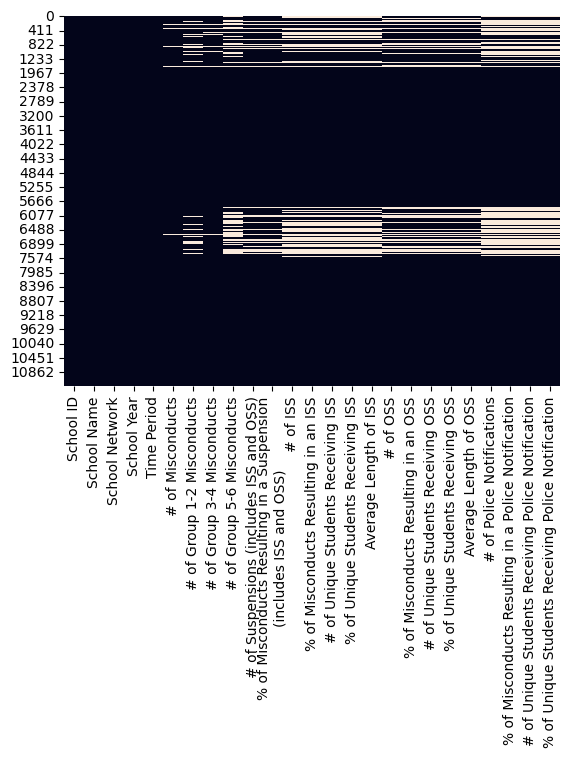

In [197]:
#visualizing NA Values
import seaborn as sns
import matplotlib.pyplot as plt
sns.heatmap(disc_df.isnull(), cbar=False) #seeing the extent of null values


In [198]:
#since we are comparing data over 10 years, we must drop schools that have an NA for any year because they will not be fairly contributing to the sum
filt_disc_df = filt_disc_df.dropna() 
filt_disc_df = filt_disc_df.astype(int)
filt_disc_df

ValueError: invalid literal for int() with base 10: '--'

In [199]:
filt_disc_df = filt_disc_df[~filt_disc_df.isin(["--"]).any(axis=1)]
filt_disc_df = filt_disc_df.astype(int)
filt_disc_df

,School ID,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),% of Misconducts Resulting in a Suspension\n(includes ISS and OSS),# of ISS,% of Misconducts Resulting in an ISS,# of Unique Students Receiving ISS,...,Average Length of ISS,# of OSS,% of Misconducts Resulting in an OSS,# of Unique Students Receiving OSS,% of Unique Students Receiving OSS,Average Length of OSS,# of Police Notifications,% of Misconducts Resulting in a Police Notification,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification
3,610513,123,62,59,2,38,30,30,24,21,...,1,8,6,8,7,1,3,2,3,2
6,610524,209,98,99,12,96,45,70,33,41,...,1,26,12,19,5,1,6,2,6,1
7,609848,263,134,111,18,29,11,16,6,14,...,1,13,4,8,3,1,3,1,1,0
8,609695,772,376,316,80,319,41,184,23,85,...,1,135,17,69,4,2,15,1,15,1
12,610287,40,14,22,4,15,37,5,12,5,...,1,10,25,4,1,1,1,2,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11251,610315,9,2,7,0,8,88,0,0,0,...,0,8,88,7,3,2,0,0,0,0
11252,610227,29,8,19,2,23,79,9,31,8,...,1,14,48,14,1,1,0,0,0,0
11255,610380,92,13,73,6,80,87,18,19,18,...,1,62,67,42,14,3,36,39,24,8
11258,610392,50,31,19,0,28,56,9,18,8,...,1,19,38,18,5,2,0,0,0,0


In [200]:
sum_disc_df = (
    filt_disc_df
    .groupby(['School ID'], as_index=False)
    .sum(numeric_only=True)
)

sum_disc_df #we see the final df with all of the null IDs has 421 rows, thus we have dropped about 300 schools. However this is essential for accurate analysis of total misconducts over the years

,School ID,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),% of Misconducts Resulting in a Suspension\n(includes ISS and OSS),# of ISS,% of Misconducts Resulting in an ISS,# of Unique Students Receiving ISS,...,Average Length of ISS,# of OSS,% of Misconducts Resulting in an OSS,# of Unique Students Receiving OSS,% of Unique Students Receiving OSS,Average Length of OSS,# of Police Notifications,% of Misconducts Resulting in a Police Notification,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification
0,400068,4109,2656,1372,81,1047,459,489,220,356,...,18,558,236,401,95,26,13,7,11,2
1,400091,1528,593,540,395,964,937,315,235,244,...,16,649,697,502,150,37,25,48,24,4
2,400137,914,485,279,150,680,1003,348,353,241,...,14,332,644,254,180,28,52,136,52,32
3,609674,3820,722,2056,1042,2527,1013,467,203,423,...,18,2060,805,1581,178,38,1610,659,1251,135
4,609676,13070,6279,6079,712,10567,913,6193,254,2036,...,16,4374,652,2209,295,40,253,97,234,32
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
416,610558,16801,13179,2888,734,4406,633,2316,242,1329,...,18,2090,384,1291,174,24,384,81,297,29
417,610559,2860,1331,1313,216,1446,1016,906,652,670,...,20,540,354,320,45,27,68,48,57,5
418,610561,2118,1076,859,183,1024,752,377,166,303,...,12,647,583,511,125,32,120,101,102,21
419,610563,842,232,300,310,451,1039,21,80,21,...,20,430,953,368,35,38,31,124,31,1


In [201]:
sum_disc_df[["% of Misconducts Resulting in a Suspension\n(includes ISS and OSS)", "% of Misconducts Resulting in an ISS", "% of Unique Students Receiving ISS", "% of Misconducts Resulting in an OSS", "% of Unique Students Receiving OSS", "% of Misconducts Resulting in a Police Notification", "% of Unique Students Receiving Police Notification"]] = sum_disc_df[["% of Misconducts Resulting in a Suspension\n(includes ISS and OSS)", "% of Misconducts Resulting in an ISS", "% of Unique Students Receiving ISS", "% of Misconducts Resulting in an OSS", "% of Unique Students Receiving OSS", "% of Misconducts Resulting in a Police Notification", "% of Unique Students Receiving Police Notification"]] / 10
sum_disc_df

,School ID,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),% of Misconducts Resulting in a Suspension\n(includes ISS and OSS),# of ISS,% of Misconducts Resulting in an ISS,# of Unique Students Receiving ISS,...,Average Length of ISS,# of OSS,% of Misconducts Resulting in an OSS,# of Unique Students Receiving OSS,% of Unique Students Receiving OSS,Average Length of OSS,# of Police Notifications,% of Misconducts Resulting in a Police Notification,# of Unique Students Receiving Police Notification,% of Unique Students Receiving Police Notification
0,400068,4109,2656,1372,81,1047,45.9,489,22.0,356,...,18,558,23.6,401,9.5,26,13,0.7,11,0.2
1,400091,1528,593,540,395,964,93.7,315,23.5,244,...,16,649,69.7,502,15.0,37,25,4.8,24,0.4
2,400137,914,485,279,150,680,100.3,348,35.3,241,...,14,332,64.4,254,18.0,28,52,13.6,52,3.2
3,609674,3820,722,2056,1042,2527,101.3,467,20.3,423,...,18,2060,80.5,1581,17.8,38,1610,65.9,1251,13.5
4,609676,13070,6279,6079,712,10567,91.3,6193,25.4,2036,...,16,4374,65.2,2209,29.5,40,253,9.7,234,3.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
416,610558,16801,13179,2888,734,4406,63.3,2316,24.2,1329,...,18,2090,38.4,1291,17.4,24,384,8.1,297,2.9
417,610559,2860,1331,1313,216,1446,101.6,906,65.2,670,...,20,540,35.4,320,4.5,27,68,4.8,57,0.5
418,610561,2118,1076,859,183,1024,75.2,377,16.6,303,...,12,647,58.3,511,12.5,32,120,10.1,102,2.1
419,610563,842,232,300,310,451,103.9,21,8.0,21,...,20,430,95.3,368,3.5,38,31,12.4,31,0.1


In [202]:
merged = sum_disc_df.merge(final_fin_df, on="School ID", how="inner")
full_df = merged.merge(final_race_df, on="School ID", how="inner")
full_df.columns #a full df of schools, misconduct types, and economic and racial deogrpahics!

Index(['School ID', '# of Misconducts', '# of Group 1-2 Misconducts',
       '# of Group 3-4 Misconducts', '# of Group 5-6 Misconducts',
       '# of Suspensions (includes ISS and OSS)',
       '% of Misconducts Resulting in a Suspension\n(includes ISS and OSS)',
       '# of ISS', '% of Misconducts Resulting in an ISS',
       '# of Unique Students Receiving ISS',
       '% of Unique Students Receiving ISS', 'Average Length of ISS',
       '# of OSS', '% of Misconducts Resulting in an OSS',
       '# of Unique Students Receiving OSS',
       '% of Unique Students Receiving OSS', 'Average Length of OSS',
       '# of Police Notifications',
       '% of Misconducts Resulting in a Police Notification',
       '# of Unique Students Receiving Police Notification',
       '% of Unique Students Receiving Police Notification', 'School Name',
       'Network_x', 'Total_x', 'Bilingual N', 'Bilingual %', 'SpED N',
       'SpED %', 'Economically Disadvantaged N',
       'Economically Disadvantage

In [ ]:
#DATA EXPLORATION

In [203]:
full_df[["# of Misconducts", "African American Pct"]].corr()

,# of Misconducts,African American Pct
# of Misconducts,1.000000,0.011524
African American Pct,0.011524,1.000000


In [204]:
full_df[["# of Misconducts", "African American Pct"]].corr()

,# of Misconducts,African American Pct
# of Misconducts,1.000000,0.011524
African American Pct,0.011524,1.000000


In [205]:
full_df.to_csv("full_df.csv", index=False)

<Axes: xlabel='# of Misconducts', ylabel='Economically Disadvantaged %'>

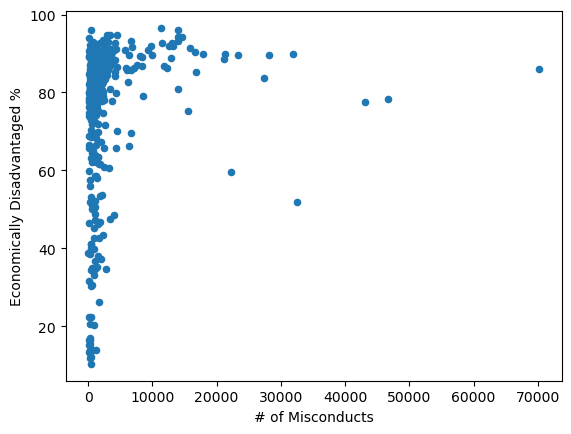

In [206]:
full_df[["# of Misconducts", "Economically Disadvantaged %"]].plot.scatter(x="# of Misconducts", y="Economically Disadvantaged %")

In [207]:
full_df.groupby("Network_x")["# of Misconducts"].mean().sort_values()

Network_x
Network 2       708.533333
Network 1       816.517241
Network 7       854.916667
Options         914.000000
Network 4       987.160000
Network 8      1060.600000
Network 12     1106.666667
Network 11     1109.000000
ISP            1113.348485
Network 6      1206.764706
Network 5      1266.571429
Network 13     1378.807692
Network 3      1523.588235
Network 10     1545.958333
Network 9      1650.769231
Contract       2818.500000
AUSL           4069.000000
Network 16     8447.285714
Network 15    10304.894737
Network 14    11582.555556
Network 17    12327.411765
Name: # of Misconducts, dtype: float64

In [208]:
full_df["Predom AfAm"] = full_df["African American Pct"] > 65
full_df["Predom AfAm"].sum()

168

In [209]:
full_df

,School ID,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),% of Misconducts Resulting in a Suspension\n(includes ISS and OSS),# of ISS,% of Misconducts Resulting in an ISS,# of Unique Students Receiving ISS,...,Hispanic Pct,Mulit-Racial No,Mulit-Racial Pct,Asian No,Asian Pct,Hawaiian/\nPacific Islander No,Hawaiian/\nPacific Islander Pct,Not \nAvailable No,Not \nAvailable Pct,Predom AfAm
0,400068,4109,2656,1372,81,1047,45.9,489,22.0,356,...,1.16,0.00,0.00,0.22,0.04,0.00,0.00,0.22,0.10,True
1,400091,1528,593,540,395,964,93.7,315,23.5,244,...,19.37,1.55,0.38,2.56,0.76,0.45,0.06,0.40,0.12,True
2,400137,914,485,279,150,680,100.3,348,35.3,241,...,0.69,1.22,0.87,0.00,0.00,0.11,0.11,0.10,0.00,True
3,609674,3820,722,2056,1042,2527,101.3,467,20.3,423,...,2.00,3.20,0.38,0.56,0.07,0.00,0.00,1.82,0.16,True
4,609676,13070,6279,6079,712,10567,91.3,6193,25.4,2036,...,2.54,1.50,0.17,0.50,0.04,0.11,0.03,0.36,0.03,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
416,610558,16801,13179,2888,734,4406,63.3,2316,24.2,1329,...,48.48,4.91,0.77,1.56,0.18,0.82,0.07,1.00,0.16,False
417,610559,2860,1331,1313,216,1446,101.6,906,65.2,670,...,96.79,0.40,0.04,1.44,0.23,0.67,0.10,0.33,0.06,False
418,610561,2118,1076,859,183,1024,75.2,377,16.6,303,...,21.64,2.27,0.59,3.33,0.81,0.27,0.02,3.00,0.68,True
419,610563,842,232,300,310,451,103.9,21,8.0,21,...,90.41,0.00,0.00,33.36,4.54,0.44,0.04,0.10,0.00,False


In [ ]:
scale_rows = ['# of Misconducts', '# of Group 1-2 Misconducts',
        '# of Group 3-4 Misconducts', '# of Group 5-6 Misconducts', '# of Suspensions (includes ISS and OSS)',
        '# of ISS', '# of Unique Students Receiving ISS', '# of OSS', '# of Unique Students Receiving OSS',
        '# of Police Notifications', '# of Unique Students Receiving Police Notification',] 

scale_df = full_df.copy()
scale_df[scale_rows] = full_df[scale_rows].div(full_df["Total_x"], axis=0) * 100
scale_df


Text(0.5, 1.0, '% of Misconducts Resulting in a Police Notification')

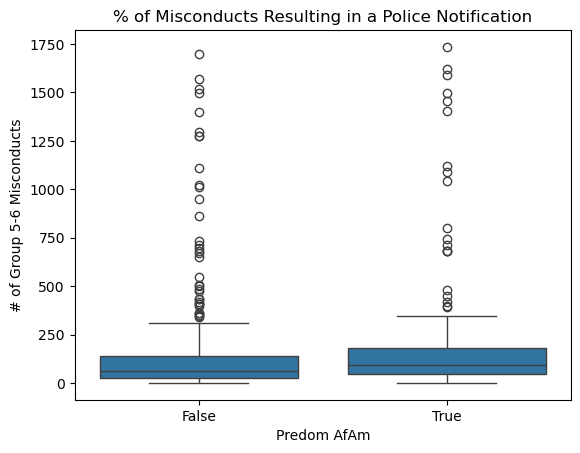

In [210]:
sns.boxplot(data=full_df, x="Predom AfAm", y="# of Group 5-6 Misconducts")
plt.title("% of Misconducts Resulting in a Police Notification")

In [506]:
#we cactually dont see to large of a range of misconducts resulting in police notification
full_df.groupby("Network_x")["% of Misconducts Resulting in a Police Notification"].mean().sort_values()

Network_x
Contract       2.750000
Network 13     4.011538
Network 1      4.641379
Network 9      4.838462
Network 7      4.841667
Network 10     5.008333
Network 8      5.073333
Network 4      5.276000
AUSL           5.793333
Network 2      5.833333
Network 6      6.011765
Network 15     6.710526
ISP            7.062121
Network 11     7.993750
Network 3      8.158824
Network 16     9.100000
Network 14    10.044444
Network 12    10.262500
Network 17    11.917647
Options       13.600000
Network 5     15.238095
Name: % of Misconducts Resulting in a Police Notification, dtype: float64

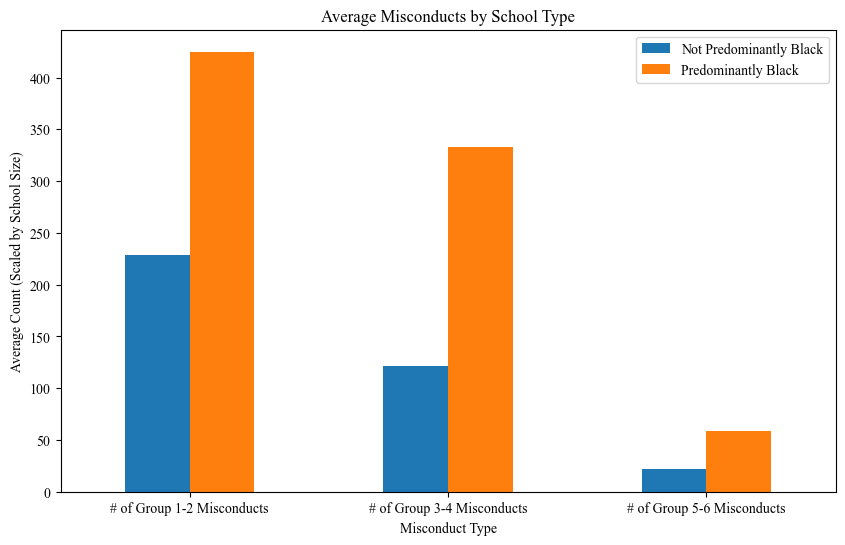

In [507]:
#I wonder if we see any disparities between what punishments predominantly african american schools recieve to their non-predominantly african american counterparts
means = scale_df.groupby("Predom AfAm")[
    ["# of Group 1-2 Misconducts", '# of Group 3-4 Misconducts', "# of Group 5-6 Misconducts"]
].mean().T

means.plot(kind="bar", figsize=(10, 6))
plt.title("Average Misconducts by School Type")
plt.ylabel("Average Count (Scaled by School Size)")
plt.xlabel("Misconduct Type")
plt.xticks(rotation=0)
plt.legend(["Not Predominantly Black", "Predominantly Black"])
plt.show()

In [508]:
scale_df["Low Econ"] = scale_df["Economically Disadvantaged %"] > scale_df["Economically Disadvantaged %"].quantile(0.75)
scale_df["Low Econ"]

0       True
1       True
2      False
3       True
4       True
       ...  
416    False
417     True
418    False
419     True
420    False
Name: Low Econ, Length: 421, dtype: bool

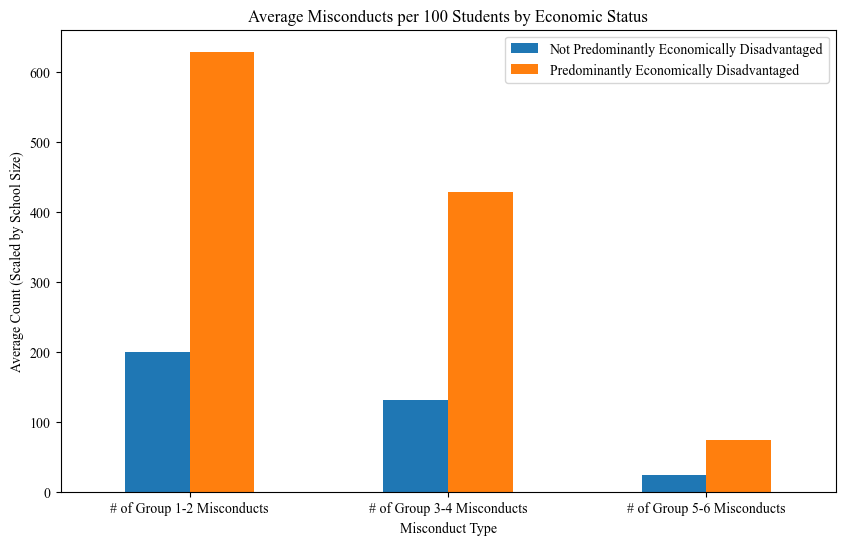

In [509]:
means = scale_df.groupby("Low Econ")[
    ["# of Group 1-2 Misconducts", '# of Group 3-4 Misconducts', "# of Group 5-6 Misconducts"]
].mean().T

means.plot(kind="bar", figsize=(10, 6))
plt.title("Average Misconducts per 100 Students by Economic Status")
plt.ylabel("Average Count (Scaled by School Size)")
plt.xlabel("Misconduct Type")
plt.xticks(rotation=0)
plt.legend(["Not Predominantly Economically Disadvantaged", "Predominantly Economically Disadvantaged"])
plt.show()

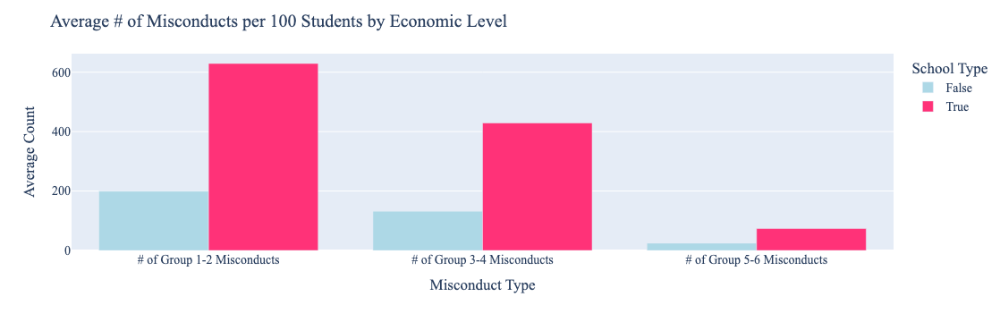

In [510]:
means = scale_df.groupby("Low Econ")[
    ["# of Group 1-2 Misconducts", '# of Group 3-4 Misconducts', "# of Group 5-6 Misconducts"]
].mean().T

means = means.reset_index().melt(id_vars="index", var_name="School Type", value_name="Average Count")
means.rename(columns={"index": "Misconduct Type"}, inplace=True)

#color map
color_map = {
    True: 'rgb(255,50,120)',    
    False: 'rgb(173,216,230)'      
}

# Plot with plotly
fig = px.bar(
    means,
    x="Misconduct Type",
    y="Average Count",
    color="School Type",
    barmode="group",
    color_discrete_map=color_map
)

fig.update_layout(
    title="Average # of Misconducts per 100 Students by Economic Level",
    xaxis_title="Misconduct Type",
    yaxis_title="Average Count",
    legend_title="School Type",
    font=dict(family="Times New Roman", size=14),
    bargap=0.2
)

fig.show()

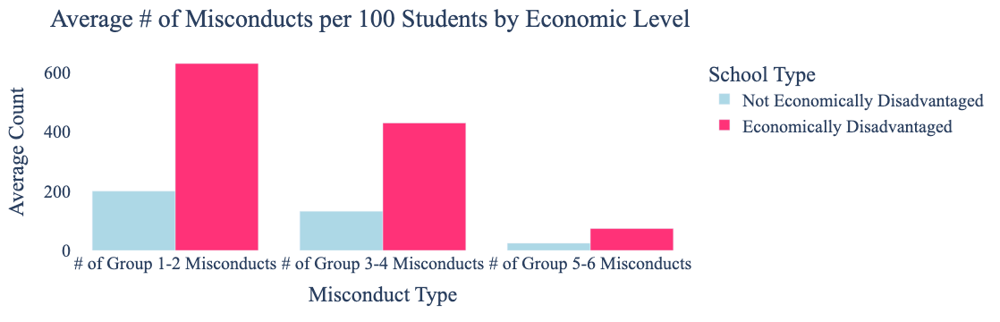

In [511]:
means["School Type"] = means["School Type"].map({
    True: "Economically Disadvantaged",
    False: "Not Economically Disadvantaged"
})

color_map = {
    "Economically Disadvantaged": 'rgb(255,50,120)',
    "Not Economically Disadvantaged": 'rgb(173,216,230)'
}

fig = px.bar(
    means,
    x="Misconduct Type",
    y="Average Count",
    color="School Type",
    barmode="group",
    color_discrete_map=color_map
)

fig.update_layout(
    title="Average # of Misconducts per 100 Students by Economic Level",
    xaxis_title="Misconduct Type",
    yaxis_title="Average Count",
    legend_title="School Type",
    font=dict(family="Times New Roman", size=20),
    bargap=0.2,
    plot_bgcolor='white',  
    paper_bgcolor='white', 
)

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)

fig.show()

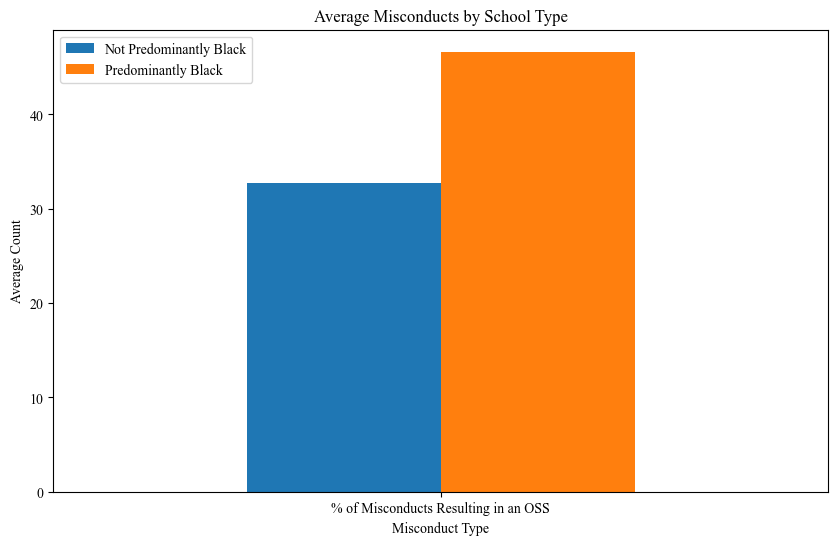

In [512]:
means = full_df.groupby("Predom AfAm")[
    ["% of Misconducts Resulting in an OSS"]
].mean().T

means.plot(kind="bar", figsize=(10, 6))
plt.title("Average Misconducts by School Type")
plt.ylabel("Average Count")
plt.xlabel("Misconduct Type")
plt.xticks(rotation=0)
plt.legend(["Not Predominantly Black", "Predominantly Black"])
plt.show()

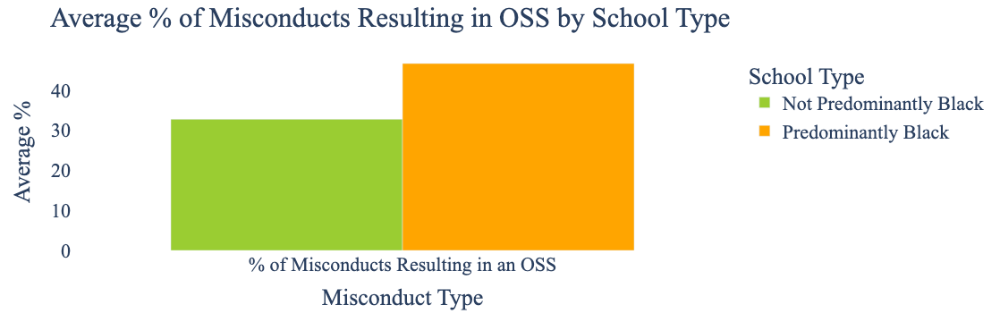

In [515]:
means = full_df.groupby("Predom AfAm")[["% of Misconducts Resulting in an OSS"]].mean().T
means = means.reset_index().melt(id_vars="index", var_name="School Type", value_name="Average Count")
means.rename(columns={"index": "Misconduct Type"}, inplace=True)

means["School Type"] = means["School Type"].map({
    False: "Not Predominantly Black",
    True: "Predominantly Black"
})

# Define color map
color_map = {
    "Not Predominantly Black": "yellowgreen",
    "Predominantly Black": "orange"
}

# Create plotly bar chart
fig = px.bar(
    means,
    x="Misconduct Type",
    y="Average Count",
    color="School Type",
    barmode="group",
    color_discrete_map=color_map
)

# Layout tweaks
fig.update_layout(
    title="Average % of Misconducts Resulting in OSS by School Type",
    xaxis_title="Misconduct Type",
    yaxis_title="Average %",
    legend_title="School Type",
    font=dict(family="Times New Roman", size=22),
    bargap=0.3,
    plot_bgcolor='white',
    paper_bgcolor='white',        # Space between groups
)

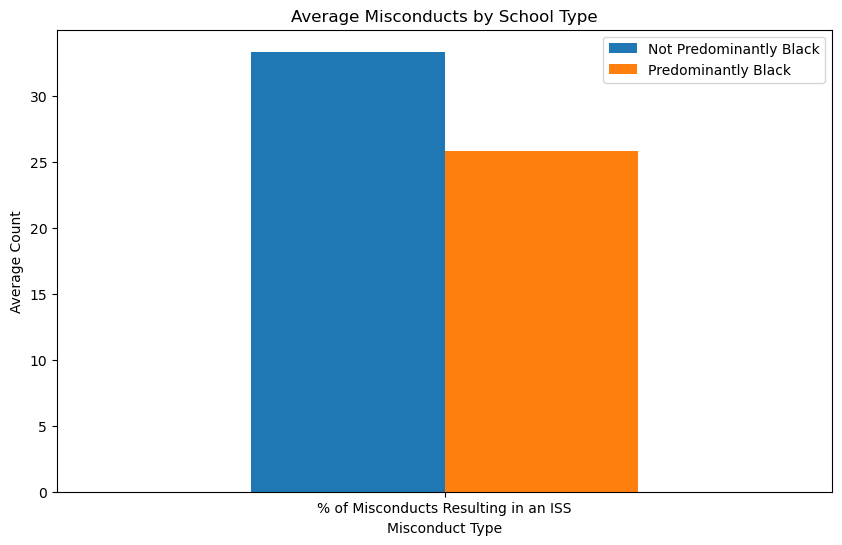

In [214]:
means = full_df.groupby("Predom AfAm")[
    ["% of Misconducts Resulting in an ISS"]
].mean().T

means.plot(kind="bar", figsize=(10, 6))
plt.title("Average Misconducts by School Type")
plt.ylabel("Average Count")
plt.xlabel("Misconduct Type")
plt.xticks(rotation=0)
plt.legend(["Not Predominantly Black", "Predominantly Black"])
plt.show()

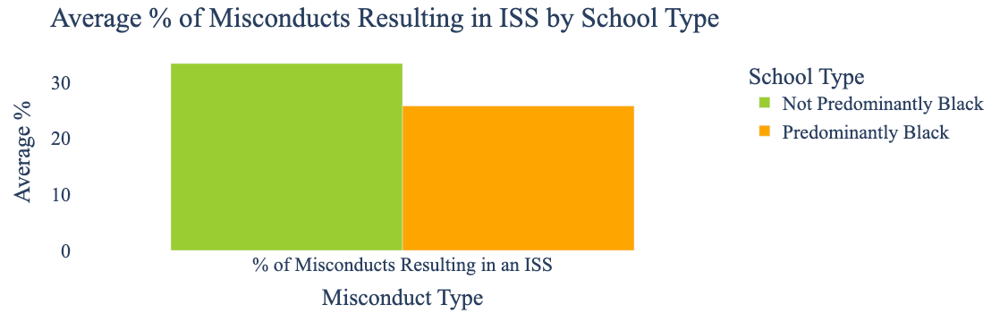

In [516]:
means = full_df.groupby("Predom AfAm")[["% of Misconducts Resulting in an ISS"]].mean().T
means = means.reset_index().melt(id_vars="index", var_name="School Type", value_name="Average Count")
means.rename(columns={"index": "Misconduct Type"}, inplace=True)

# Rename legend labels
means["School Type"] = means["School Type"].map({
    False: "Not Predominantly Black",
    True: "Predominantly Black"
})

# Define color map
color_map = {
    "Not Predominantly Black": "yellowgreen",
    "Predominantly Black": "orange"
}

fig = px.bar(
    means,
    x="Misconduct Type",
    y="Average Count",
    color="School Type",
    barmode="group",
    color_discrete_map=color_map
)

fig.update_layout(
    title="Average % of Misconducts Resulting in ISS by School Type",
    xaxis_title="Misconduct Type",
    yaxis_title="Average %",
    legend_title="School Type",
    font=dict(family="Times New Roman", size=22),
    bargap=0.3,
    plot_bgcolor='white',
    paper_bgcolor='white',        # Space between groups
)

<Axes: xlabel='Network_x'>

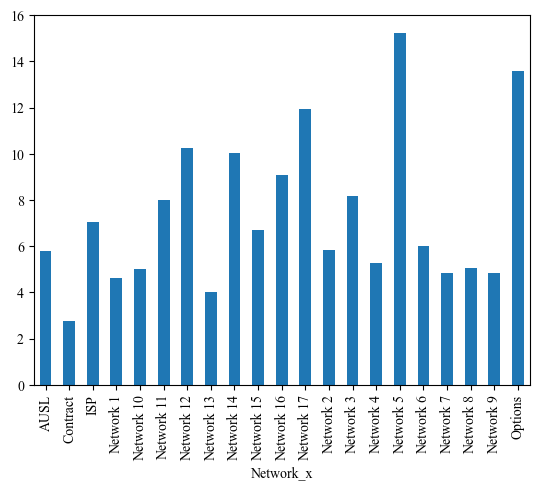

In [458]:
#checking if theres any interesting police data again
scale_df.groupby("Network_x")["% of Misconducts Resulting in a Police Notification"].mean().plot.bar()

In [ ]:
#GEOGRAPHIC DATA EXPLORATION

In [215]:
df_elem_networks = pd.read_csv("network1-13_shapefile.csv")
df_elem_networks

,PlanningZo,NetworkNum,the_geom
0,Far South Side - Far East Side,13,MULTIPOLYGON (((-87.52948021251774 41.73234267...
1,Midway-Chgo Lawn-Ashburn-Beverly,10,MULTIPOLYGON (((-87.74295868650016 41.80032747...
2,Englewood-Auburn Gresham,11,MULTIPOLYGON (((-87.63157412008636 41.80181247...
3,Bronzeville-Hyde Park-Woodlawn,9,MULTIPOLYGON (((-87.60871811103908 41.84682690...
4,Pilsen-Little Village,7,MULTIPOLYGON (((-87.63899894964086 41.85955448...
5,McKinley Park,8,MULTIPOLYGON (((-87.66336061162971 41.83763552...
6,Near N-Near W-Loop-BridgePort-Chinatown,6,MULTIPOLYGON (((-87.61010880186276 41.87412995...
7,Humboldt Park-Garfield W-N Lawndale,5,MULTIPOLYGON (((-87.68731885819079 41.91415007...
8,Saug-ReedDunning-AlbanyPk,1,MULTIPOLYGON (((-87.80655165600717 42.01871833...
9,Belmont-Austin,3,MULTIPOLYGON (((-87.74137265178526 41.90922505...


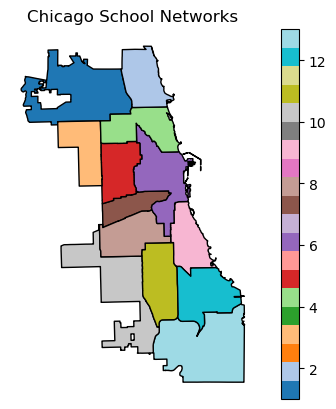

In [216]:
import geopandas as gpd
from shapely import wkt
import matplotlib.pyplot as plt

df_elem_networks["geometry"] = df_elem_networks["the_geom"].apply(wkt.loads)

gdf = gpd.GeoDataFrame(df_elem_networks, geometry="geometry", crs="EPSG:4326")

gdf.plot(column="NetworkNum", cmap="tab20", legend=True, edgecolor="black")
plt.title("Chicago School Networks")
plt.axis("off")
plt.show()


In [69]:
!pip install geopandas shapely pyproj fiona

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 12.8 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.8/14.8 MB 11.3 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.5/19.5 MB 14.0 MB/s eta 0:00:00a 0:00:01


In [72]:
full_df

,School ID,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),% of Misconducts Resulting in a Suspension\n(includes ISS and OSS),# of ISS,% of Misconducts Resulting in an ISS,# of Unique Students Receiving ISS,...,Hispanic Pct,Mulit-Racial No,Mulit-Racial Pct,Asian No,Asian Pct,Hawaiian/\nPacific Islander No,Hawaiian/\nPacific Islander Pct,Not \nAvailable No,Not \nAvailable Pct,Predom AfAm
0,400068,4109,2656,1372,81,1047,45.9,489,22.0,356,...,1.16,0.00,0.00,0.22,0.04,0.00,0.00,0.22,0.10,True
1,400091,1528,593,540,395,964,93.7,315,23.5,244,...,19.37,1.55,0.38,2.56,0.76,0.45,0.06,0.40,0.12,True
2,400137,914,485,279,150,680,100.3,348,35.3,241,...,0.69,1.22,0.87,0.00,0.00,0.11,0.11,0.10,0.00,True
3,609674,3820,722,2056,1042,2527,101.3,467,20.3,423,...,2.00,3.20,0.38,0.56,0.07,0.00,0.00,1.82,0.16,True
4,609676,13070,6279,6079,712,10567,91.3,6193,25.4,2036,...,2.54,1.50,0.17,0.50,0.04,0.11,0.03,0.36,0.03,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
416,610558,16801,13179,2888,734,4406,63.3,2316,24.2,1329,...,48.48,4.91,0.77,1.56,0.18,0.82,0.07,1.00,0.16,False
417,610559,2860,1331,1313,216,1446,101.6,906,65.2,670,...,96.79,0.40,0.04,1.44,0.23,0.67,0.10,0.33,0.06,False
418,610561,2118,1076,859,183,1024,75.2,377,16.6,303,...,21.64,2.27,0.59,3.33,0.81,0.27,0.02,3.00,0.68,True
419,610563,842,232,300,310,451,103.9,21,8.0,21,...,90.41,0.00,0.00,33.36,4.54,0.44,0.04,0.10,0.00,False


In [217]:
full_df.columns

Index(['School ID', '# of Misconducts', '# of Group 1-2 Misconducts',
       '# of Group 3-4 Misconducts', '# of Group 5-6 Misconducts',
       '# of Suspensions (includes ISS and OSS)',
       '% of Misconducts Resulting in a Suspension\n(includes ISS and OSS)',
       '# of ISS', '% of Misconducts Resulting in an ISS',
       '# of Unique Students Receiving ISS',
       '% of Unique Students Receiving ISS', 'Average Length of ISS',
       '# of OSS', '% of Misconducts Resulting in an OSS',
       '# of Unique Students Receiving OSS',
       '% of Unique Students Receiving OSS', 'Average Length of OSS',
       '# of Police Notifications',
       '% of Misconducts Resulting in a Police Notification',
       '# of Unique Students Receiving Police Notification',
       '% of Unique Students Receiving Police Notification', 'School Name',
       'Network_x', 'Total_x', 'Bilingual N', 'Bilingual %', 'SpED N',
       'SpED %', 'Economically Disadvantaged N',
       'Economically Disadvantage

In [102]:
full_df_rename = full_df.rename(columns={"Network_x": "NetworkNum"})
full_df_rename = full_df_rename[full_df_rename["NetworkNum"] != "Contract"]
full_df_rename = full_df_rename[full_df_rename["NetworkNum"] != "Options"]
df_elem_networks["NetworkNum"] = df_elem_networks["NetworkNum"].astype(int)
full_df_rename["NetworkNum"] = full_df_rename["NetworkNum"].str[8:]
full_df_rename = full_df_rename[full_df_rename["NetworkNum"] != '']
full_df_rename["NetworkNum"] = full_df_rename["NetworkNum"].astype(int)


In [103]:
full_df_rename

,School ID,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),% of Misconducts Resulting in a Suspension\n(includes ISS and OSS),# of ISS,% of Misconducts Resulting in an ISS,# of Unique Students Receiving ISS,...,Hispanic Pct,Mulit-Racial No,Mulit-Racial Pct,Asian No,Asian Pct,Hawaiian/\nPacific Islander No,Hawaiian/\nPacific Islander Pct,Not \nAvailable No,Not \nAvailable Pct,Predom AfAm
3,609674,3820,722,2056,1042,2527,101.3,467,20.3,423,...,2.00,3.20,0.38,0.56,0.07,0.00,0.00,1.82,0.16,True
4,609676,13070,6279,6079,712,10567,91.3,6193,25.4,2036,...,2.54,1.50,0.17,0.50,0.04,0.11,0.03,0.36,0.03,True
6,609679,31943,29638,1944,361,2394,45.7,1302,18.0,1026,...,75.61,4.09,0.31,4.82,0.39,1.00,0.08,0.30,0.02,False
8,609682,9856,6662,2759,435,3450,68.0,1694,29.7,992,...,56.30,0.44,0.16,0.22,0.07,0.00,0.00,4.82,1.11,False
9,609691,15825,11719,3096,1010,10592,127.7,7713,92.2,3844,...,83.42,3.00,0.29,2.55,0.23,0.55,0.02,0.40,0.03,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
414,610547,4253,3009,946,298,2822,108.8,2109,58.3,1365,...,2.89,4.70,0.86,0.80,0.14,0.44,0.08,2.09,0.33,True
416,610558,16801,13179,2888,734,4406,63.3,2316,24.2,1329,...,48.48,4.91,0.77,1.56,0.18,0.82,0.07,1.00,0.16,False
417,610559,2860,1331,1313,216,1446,101.6,906,65.2,670,...,96.79,0.40,0.04,1.44,0.23,0.67,0.10,0.33,0.06,False
418,610561,2118,1076,859,183,1024,75.2,377,16.6,303,...,21.64,2.27,0.59,3.33,0.81,0.27,0.02,3.00,0.68,True


In [104]:
geo_full_df = df_elem_networks.merge(full_df_rename, on="NetworkNum", how="left")

In [105]:
geo_full_df

,PlanningZo,NetworkNum,the_geom,geometry,School ID,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),...,Hispanic Pct,Mulit-Racial No,Mulit-Racial Pct,Asian No,Asian Pct,Hawaiian/\nPacific Islander No,Hawaiian/\nPacific Islander Pct,Not \nAvailable No,Not \nAvailable Pct,Predom AfAm
0,Far South Side - Far East Side,13,MULTIPOLYGON (((-87.52948021251774 41.73234267...,MULTIPOLYGON (((-87.52948021251774 41.73234267...,609800,486,221,191,74,207,...,1.10,4.64,1.56,0.10,0.00,0.60,0.20,0.22,0.07,True
1,Far South Side - Far East Side,13,MULTIPOLYGON (((-87.52948021251774 41.73234267...,MULTIPOLYGON (((-87.52948021251774 41.73234267...,609808,748,405,290,53,229,...,2.17,1.20,0.21,0.11,0.02,0.50,0.09,0.11,0.02,True
2,Far South Side - Far East Side,13,MULTIPOLYGON (((-87.52948021251774 41.73234267...,MULTIPOLYGON (((-87.52948021251774 41.73234267...,609811,738,208,491,39,203,...,31.12,0.22,0.08,0.00,0.00,0.00,0.00,0.11,0.04,True
3,Far South Side - Far East Side,13,MULTIPOLYGON (((-87.52948021251774 41.73234267...,MULTIPOLYGON (((-87.52948021251774 41.73234267...,609821,1627,374,1160,93,536,...,2.86,1.18,0.21,1.00,0.20,0.78,0.16,0.11,0.02,True
4,Far South Side - Far East Side,13,MULTIPOLYGON (((-87.52948021251774 41.73234267...,MULTIPOLYGON (((-87.52948021251774 41.73234267...,609845,3441,1467,1750,224,1124,...,1.30,1.44,0.36,0.00,0.00,0.00,0.00,0.22,0.06,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249,Chatham-South Shore,12,MULTIPOLYGON (((-87.62566478348738 41.77491100...,MULTIPOLYGON (((-87.62566478348738 41.77491100...,610279,1868,818,952,98,997,...,2.26,1.18,0.36,0.00,0.00,0.00,0.00,0.44,0.11,True
250,Chatham-South Shore,12,MULTIPOLYGON (((-87.62566478348738 41.77491100...,MULTIPOLYGON (((-87.62566478348738 41.77491100...,610281,1274,480,729,65,777,...,2.24,2.00,0.26,1.22,0.24,0.00,0.00,0.10,0.00,True
251,Chatham-South Shore,12,MULTIPOLYGON (((-87.62566478348738 41.77491100...,MULTIPOLYGON (((-87.62566478348738 41.77491100...,610316,132,44,77,11,62,...,2.29,3.09,1.44,0.00,0.00,0.00,0.00,0.00,0.00,True
252,Chatham-South Shore,12,MULTIPOLYGON (((-87.62566478348738 41.77491100...,MULTIPOLYGON (((-87.62566478348738 41.77491100...,610350,2673,1645,1005,23,472,...,1.27,0.55,0.04,0.00,0.00,0.00,0.00,2.22,0.48,True


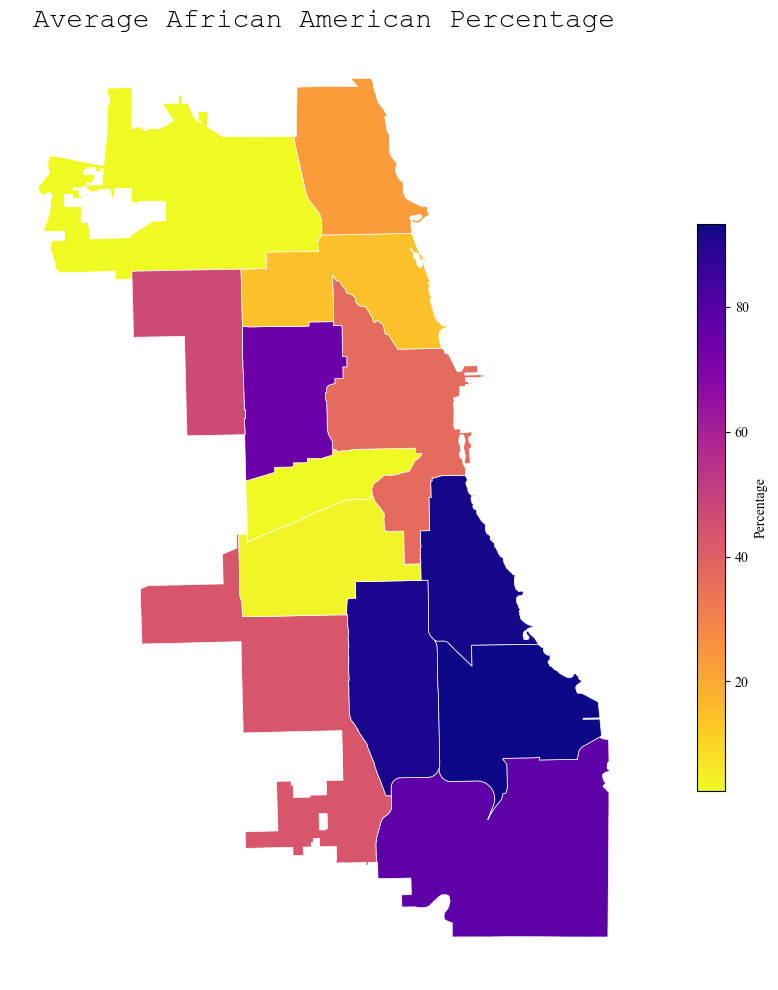

In [613]:
#Mapping distribution of predominantly african american schools in chicago
geo_full_df = gpd.GeoDataFrame(geo_full_df, geometry="geometry", crs="EPSG:4326")
network_avg = geo_full_df.groupby("NetworkNum")["African American Pct"].mean().reset_index()
network_avg.rename(columns={"African American Pct": "afam_pct"}, inplace=True)

plot_df = geo_full_df.drop_duplicates(subset="NetworkNum").drop(columns=["African American Pct"])
plot_df = plot_df.merge(network_avg, on="NetworkNum", how="left")

import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(12, 10))

plot_df.plot(
    column="afam_pct",
    cmap="plasma_r",          
    linewidth=0.5,
    edgecolor="white",
    legend=True,
    legend_kwds={
        "label": "Percentage",
        "shrink": 0.6
    },
    ax=ax
)

ax.set_title("Average African American Percentage", fontsize=20, fontname='Courier New')
ax.axis("off")
plt.tight_layout()
plt.show()


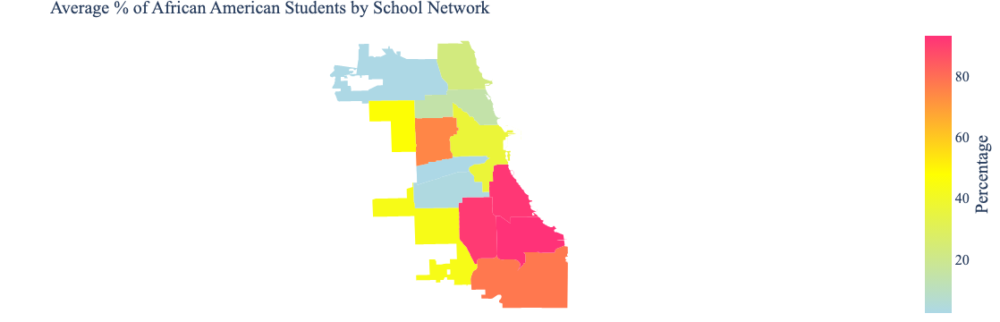

In [616]:
import json

geojson = json.loads(plot_df.to_json())

fig = px.choropleth(
    plot_df,
    geojson=geojson,
    locations="NetworkNum",
    featureidkey="properties.NetworkNum",
    color="afam_pct",
    color_continuous_scale=[  # light blue, yellow, red
        "rgb(173,216,230)",  # light blue
        "yellow",
        "rgb(255,50,120)"
    ],
    labels={"afam_pct": "Percentage"},
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title_text="Average % of African American Students by School Network",
    title_font=dict(size=20, family="Times New Roman"),
    margin={"r":0,"t":30,"l":0,"b":0},
)
fig.update_layout(
    coloraxis_colorbar=dict(
        title=dict(
            text='Percentage',
            font=dict(family='Times New Roman', size=20),
            side='right'  # vertical label
        ),
        tickfont=dict(
            family='Times New Roman',
            size=16
        )
    )
)
fig.update_traces(marker_line_width=0)
fig.show()

In [611]:
plot_df.columns

Index(['PlanningZo', 'NetworkNum', 'the_geom', 'geometry', 'School ID',
       '# of Misconducts', '# of Group 1-2 Misconducts',
       '# of Group 3-4 Misconducts', '# of Group 5-6 Misconducts',
       '# of Suspensions (includes ISS and OSS)',
       '% of Misconducts Resulting in a Suspension\n(includes ISS and OSS)',
       '# of ISS', '% of Misconducts Resulting in an ISS',
       '# of Unique Students Receiving ISS',
       '% of Unique Students Receiving ISS', 'Average Length of ISS',
       '# of OSS', '# of Unique Students Receiving OSS',
       '% of Unique Students Receiving OSS', 'Average Length of OSS',
       '# of Police Notifications',
       '% of Misconducts Resulting in a Police Notification',
       '# of Unique Students Receiving Police Notification',
       '% of Unique Students Receiving Police Notification', 'School Name',
       'Total_x', 'Bilingual N', 'Bilingual %', 'SpED N', 'SpED %',
       'Economically Disadvantaged N', 'Economically Disadvantaged %',
  

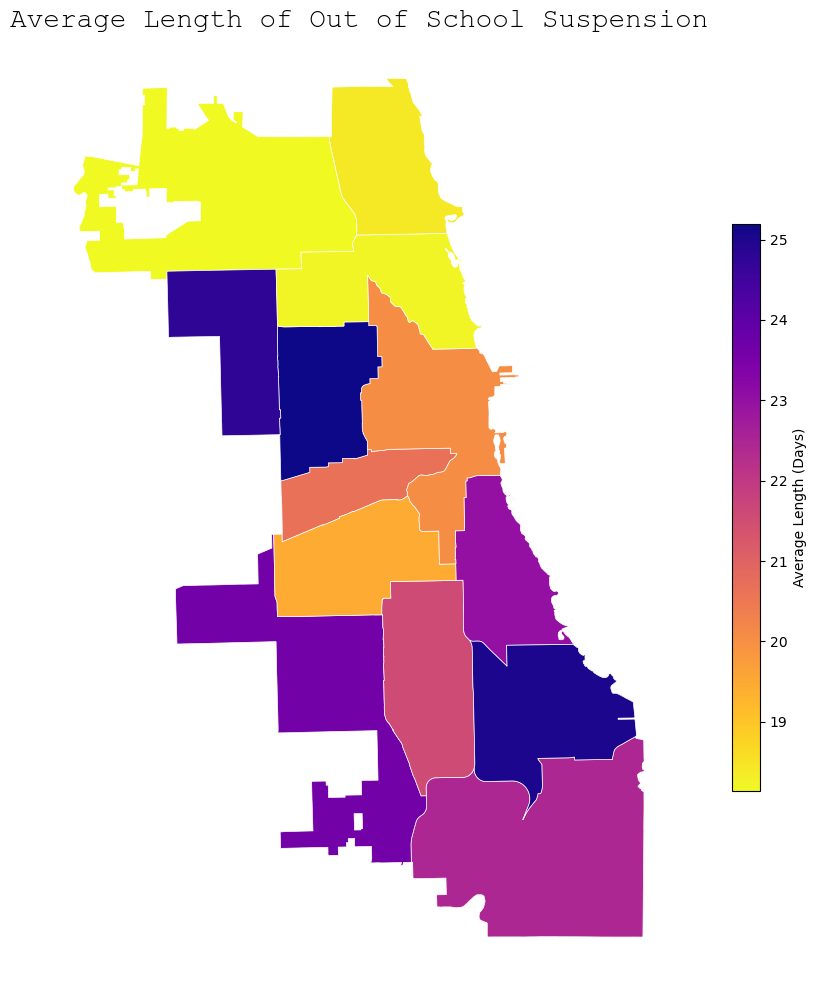

In [132]:
network_avg = geo_full_df.groupby("NetworkNum")["Average Length of OSS"].mean().reset_index()
network_avg.rename(columns={"Average Length of OSS": "mean_oss"}, inplace=True)

plot_df = geo_full_df.drop_duplicates(subset="NetworkNum").drop(columns=["Average Length of OSS"])
plot_df = plot_df.merge(network_avg, on="NetworkNum", how="left")

import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(12, 10))

plot_df.plot(
    column="mean_oss",
    cmap="plasma_r",            # dark purple = high, yellow = low
    linewidth=0.5,
    edgecolor="white",
    legend=True,
    legend_kwds={
        "label": "Average Length (Days)",
        "shrink": 0.6
    },
    ax=ax
)

ax.set_title("Average Length of Out of School Suspension", fontsize=20, fontname='Courier New')
ax.axis("off")
plt.tight_layout()
plt.show()


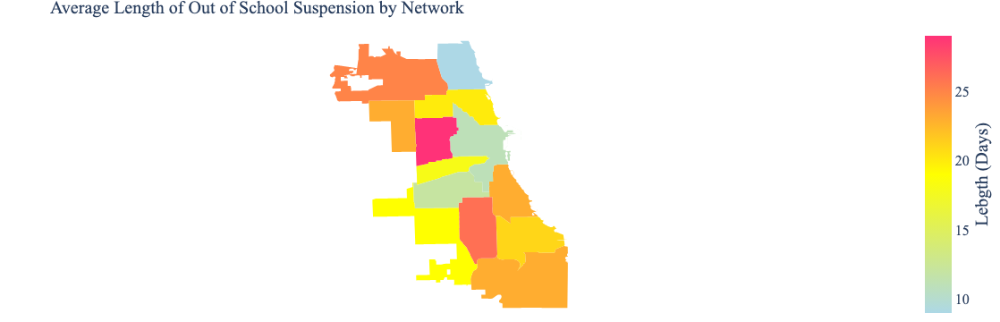

In [621]:
fig = px.choropleth(
    plot_df,
    geojson=geojson,
    locations="NetworkNum",
    featureidkey="properties.NetworkNum",
    color="Average Length of OSS",
    color_continuous_scale=[  # light blue, yellow, red
        "rgb(173,216,230)",  # light blue
        "yellow",
        "rgb(255,50,120)"
    ],
    labels={"Average Length of OSS": "Length (Days)"},
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title_text="Average Length of Out of School Suspension by Network",
    title_font=dict(size=20, family="Times New Roman"),
    margin={"r":0,"t":30,"l":0,"b":0},
)
fig.update_layout(
    coloraxis_colorbar=dict(
        title=dict(
            text='Lebgth (Days)',
            font=dict(family='Times New Roman', size=20),
            side='right'  # vertical label
        ),
        tickfont=dict(
            family='Times New Roman',
            size=16
        )
    )
)
fig.update_traces(marker_line_width=0)
fig.show()

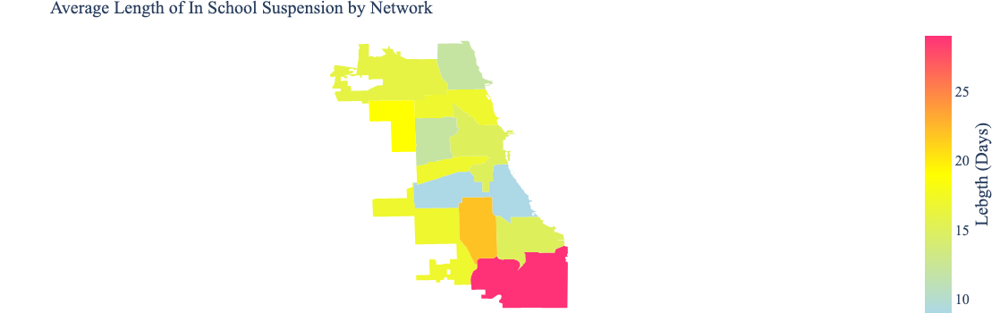

In [622]:
fig = px.choropleth(
    plot_df,
    geojson=geojson,
    locations="NetworkNum",
    featureidkey="properties.NetworkNum",
    color="Average Length of ISS",
    color_continuous_scale=[  # light blue, yellow, red
        "rgb(173,216,230)",  # light blue
        "yellow",
        "rgb(255,50,120)"
    ],
    labels={"Average Length of ISS": "Length (Days)"},
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title_text="Average Length of In School Suspension by Network",
    title_font=dict(size=20, family="Times New Roman"),
    margin={"r":0,"t":30,"l":0,"b":0},
)
fig.update_layout(
    coloraxis_colorbar=dict(
        title=dict(
            text='Lebgth (Days)',
            font=dict(family='Times New Roman', size=20),
            side='right'  # vertical label
        ),
        tickfont=dict(
            family='Times New Roman',
            size=16
        )
    )
)
fig.update_traces(marker_line_width=0)
fig.show()

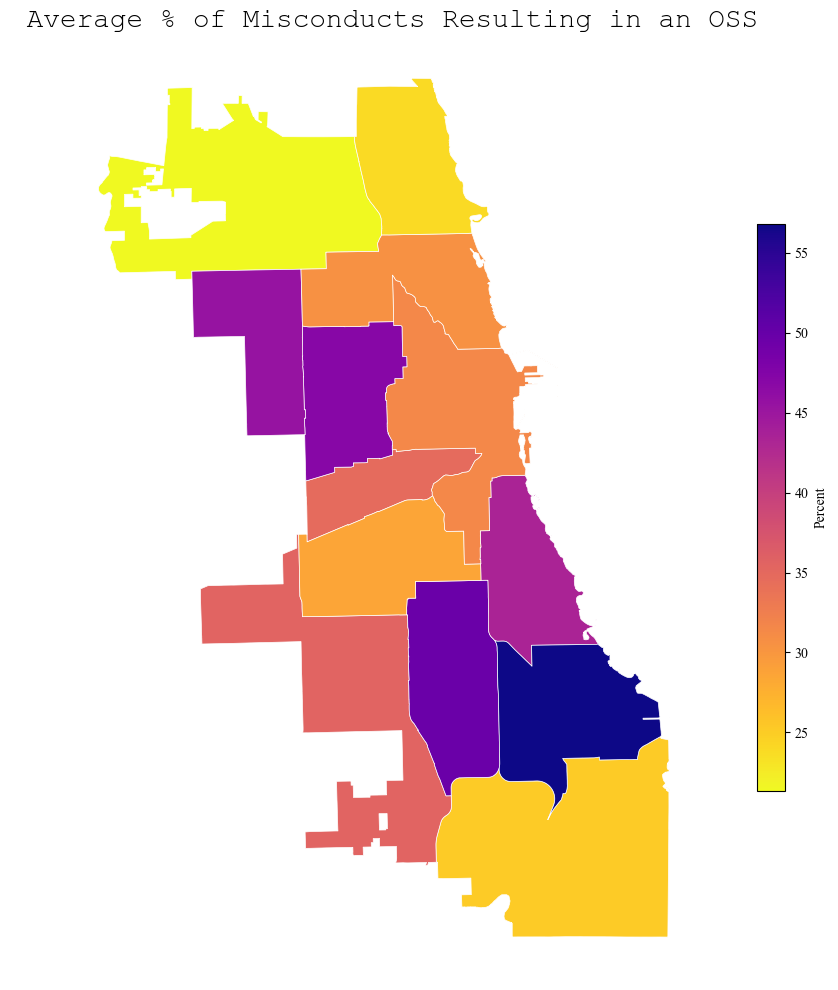

In [594]:
network_avg = geo_full_df.groupby("NetworkNum")["% of Misconducts Resulting in an OSS"].mean().reset_index()
network_avg.rename(columns={"% of Misconducts Resulting in an OSS": "mean_oss"}, inplace=True)

plot_df = geo_full_df.drop_duplicates(subset="NetworkNum").drop(columns=["% of Misconducts Resulting in an OSS"])
plot_df = plot_df.merge(network_avg, on="NetworkNum", how="left")

import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(12, 10))

plot_df.plot(
    column="mean_oss",
    cmap="plasma_r",            # dark purple = high, yellow = low
    linewidth=0.5,
    edgecolor="white",
    legend=True,
    legend_kwds={
        "label": "Percent",
        "shrink": 0.6
    },
    ax=ax
)

ax.set_title(" Average % of Misconducts Resulting in an OSS", fontsize=20, fontname='Courier New')
ax.axis("off")
plt.tight_layout()
plt.show()


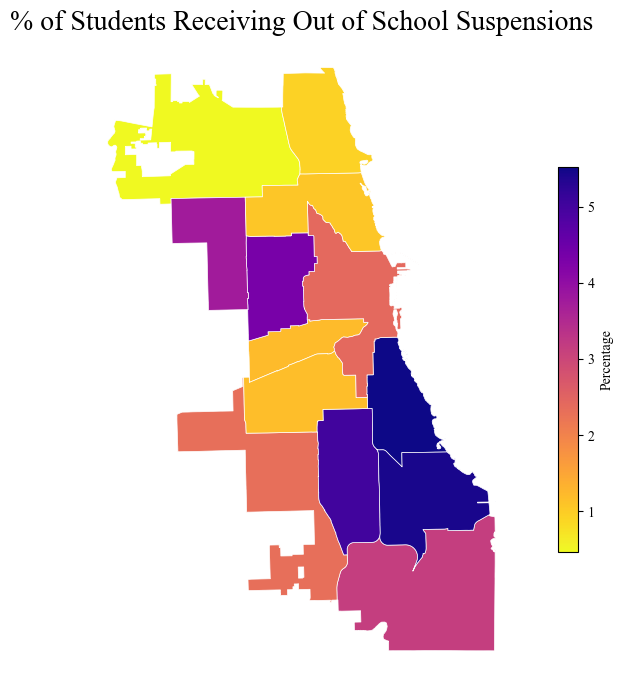

In [410]:
network_avg = geo_full_df.groupby("NetworkNum")["% of Unique Students Receiving OSS"].mean().reset_index()
network_avg.rename(columns={"% of Unique Students Receiving OSS": "mean_oss"}, inplace=True)

plot_df = geo_full_df.drop_duplicates(subset="NetworkNum").drop(columns=["% of Unique Students Receiving OSS"])
plot_df = plot_df.merge(network_avg, on="NetworkNum", how="left")

import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(9, 7))

plot_df.plot(
    column="mean_oss",
    cmap="plasma_r",            # dark purple = high, yellow = low
    linewidth=0.5,
    edgecolor="white",
    legend=True,
    legend_kwds={
        "label": "Percentage",
        "shrink": 0.6
    },
    ax=ax
)

ax.set_title("% of Students Receiving Out of School Suspensions", fontsize=20, fontname='Times New Roman')
ax.axis("off")
plt.tight_layout()
plt.show()

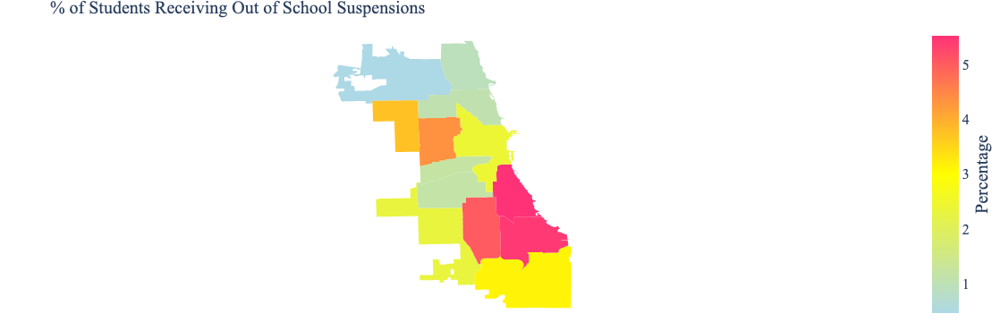

In [504]:
import json

# plot_df must have a unique identifier for each polygon
geojson = json.loads(plot_df.to_json())

fig = px.choropleth(
    plot_df,
    geojson=geojson,
    locations="NetworkNum",
    featureidkey="properties.NetworkNum",
    color="mean_oss",
    color_continuous_scale=[  # light blue, yellow, red
        "rgb(173,216,230)",  # light blue
        "yellow",
        "rgb(255,50,120)"
    ],
    labels={"mean_oss": "Percentage"},
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title_text="% of Students Receiving Out of School Suspensions",
    title_font=dict(size=20, family="Times New Roman"),
    margin={"r":0,"t":30,"l":0,"b":0},
)
fig.update_layout(
    coloraxis_colorbar=dict(
        title=dict(
            text='Percentage',
            font=dict(family='Times New Roman', size=20),
            side='right'  # vertical label
        ),
        tickfont=dict(
            family='Times New Roman',
            size=16
        )
    )
)
fig.update_traces(marker_line_width=0)
fig.show()

In [406]:
scale_df.groupby("Network_x")["% of Unique Students Receiving Police Notification"].mean().sort_values(ascending=False)

Network_x
Network 17    4.888235
Network 15    3.694737
Network 16    3.592857
Options       3.200000
Network 14    1.972222
AUSL          0.666667
Network 5     0.623810
Network 12    0.437500
Network 9     0.376923
Network 3     0.358824
Network 13    0.338462
Contract      0.300000
Network 11    0.281250
Network 6     0.211765
ISP           0.166667
Network 10    0.120833
Network 8     0.073333
Network 7     0.033333
Network 4     0.028000
Network 2     0.026667
Network 1     0.024138
Name: % of Unique Students Receiving Police Notification, dtype: float64

In [141]:
full_df.columns

Index(['School ID', '# of Misconducts', '# of Group 1-2 Misconducts',
       '# of Group 3-4 Misconducts', '# of Group 5-6 Misconducts',
       '# of Suspensions (includes ISS and OSS)',
       '% of Misconducts Resulting in a Suspension\n(includes ISS and OSS)',
       '# of ISS', '% of Misconducts Resulting in an ISS',
       '# of Unique Students Receiving ISS',
       '% of Unique Students Receiving ISS', 'Average Length of ISS',
       '# of OSS', '% of Misconducts Resulting in an OSS',
       '# of Unique Students Receiving OSS',
       '% of Unique Students Receiving OSS', 'Average Length of OSS',
       '# of Police Notifications',
       '% of Misconducts Resulting in a Police Notification',
       '# of Unique Students Receiving Police Notification',
       '% of Unique Students Receiving Police Notification', 'School Name',
       'Network_x', 'Total_x', 'Bilingual N', 'Bilingual %', 'SpED N',
       'SpED %', 'Economically Disadvantaged N',
       'Economically Disadvantage

In [230]:
scale_df

,School ID,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),% of Misconducts Resulting in a Suspension\n(includes ISS and OSS),# of ISS,% of Misconducts Resulting in an ISS,# of Unique Students Receiving ISS,...,Hispanic Pct,Mulit-Racial No,Mulit-Racial Pct,Asian No,Asian Pct,Hawaiian/\nPacific Islander No,Hawaiian/\nPacific Islander Pct,Not \nAvailable No,Not \nAvailable Pct,Predom AfAm
0,400068,1413.095811,913.405324,471.834377,27.856111,360.066029,45.9,168.168375,22.0,122.429328,...,1.16,0.00,0.00,0.22,0.04,0.00,0.00,0.22,0.10,True
1,400091,450.591254,174.869511,159.240364,116.481378,284.273540,93.7,92.890213,23.5,71.953054,...,19.37,1.55,0.38,2.56,0.76,0.45,0.06,0.40,0.12,True
2,400137,795.543563,422.142919,242.840978,130.559666,591.870485,100.3,302.898425,35.3,209.765863,...,0.69,1.22,0.87,0.00,0.00,0.11,0.11,0.10,0.00,True
3,609674,488.004292,92.235366,262.653619,133.115307,322.823782,101.3,59.659163,20.3,54.038172,...,2.00,3.20,0.38,0.56,0.07,0.00,0.00,1.82,0.16,True
4,609676,2816.142725,1352.912025,1309.818793,153.411907,2276.830924,91.3,1334.381935,25.4,438.689104,...,2.54,1.50,0.17,0.50,0.04,0.11,0.03,0.36,0.03,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
416,610558,1829.955016,1435.448911,314.559258,79.946847,479.898923,63.3,252.257355,24.2,144.753897,...,48.48,4.91,0.77,1.56,0.18,0.82,0.07,1.00,0.16,False
417,610559,512.848100,238.671616,235.443901,38.732584,259.293130,101.6,162.461671,65.2,120.142737,...,96.79,0.40,0.04,1.44,0.23,0.67,0.10,0.33,0.06,False
418,610561,494.351601,251.143684,200.494818,42.713099,239.006629,75.2,87.993651,16.6,70.721688,...,21.64,2.27,0.59,3.33,0.81,0.27,0.02,3.00,0.68,True
419,610563,94.025684,25.907314,33.500838,34.617532,50.362926,103.9,2.345059,8.0,2.345059,...,90.41,0.00,0.00,33.36,4.54,0.44,0.04,0.10,0.00,False


In [231]:
scale_df.columns

Index(['School ID', '# of Misconducts', '# of Group 1-2 Misconducts',
       '# of Group 3-4 Misconducts', '# of Group 5-6 Misconducts',
       '# of Suspensions (includes ISS and OSS)',
       '% of Misconducts Resulting in a Suspension\n(includes ISS and OSS)',
       '# of ISS', '% of Misconducts Resulting in an ISS',
       '# of Unique Students Receiving ISS',
       '% of Unique Students Receiving ISS', 'Average Length of ISS',
       '# of OSS', '% of Misconducts Resulting in an OSS',
       '# of Unique Students Receiving OSS',
       '% of Unique Students Receiving OSS', 'Average Length of OSS',
       '# of Police Notifications',
       '% of Misconducts Resulting in a Police Notification',
       '# of Unique Students Receiving Police Notification',
       '% of Unique Students Receiving Police Notification', 'School Name',
       'Network_x', 'Total_x', 'Bilingual N', 'Bilingual %', 'SpED N',
       'SpED %', 'Economically Disadvantaged N',
       'Economically Disadvantage

In [ ]:
#MACHINE LEARNING

In [244]:
features = features = [
    'Bilingual %', 'SpED %', 'Economically Disadvantaged %',
    'White Pct', 'African American Pct', 'Asian Pct', 'Hispanic Pct',
    'Mulit-Racial Pct', 'Predom AfAm', 'Total_x'
]

In [464]:
#we will define the top 75% of suspending schools to be "heavy suspenders" we will predict what heavy suspenders are
susp_rate = scale_df["# of Suspensions (includes ISS and OSS)"]
threshold = susp_rate.quantile(0.75)
scale_df["Punitive"] = (susp_rate > threshold).astype(int)
scale_df["Punitive"] = scale_df["# of Suspensions (includes ISS and OSS)"] > threshold
scale_df["Punitive"]


0       True
1       True
2       True
3       True
4       True
       ...  
416     True
417     True
418     True
419    False
420    False
Name: Punitive, Length: 421, dtype: bool

In [465]:
#we will define the top 75% of schools giving students OSS schools to be "excessive suspenders" we will predict what factors most predict an excessive suspender school
oss_rate = scale_df["% of Unique Students Receiving OSS"]
threshold = oss_rate.quantile(0.75)
scale_df["Excessive"] = (oss_rate > threshold).astype(int)
scale_df["Excessive"] = scale_df["% of Unique Students Receiving OSS"] > threshold
scale_df["Excessive"]

0       True
1       True
2       True
3       True
4       True
       ...  
416     True
417    False
418     True
419    False
420    False
Name: Excessive, Length: 421, dtype: bool

In [468]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_validate
import numpy as np

X = scale_df[features]
y = scale_df["Punitive"]

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=42)

clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

clf = RandomForestClassifier(n_estimators=100, random_state=42)

# using cross validation
scores = cross_val_score(clf, X, y, cv=5, scoring='accuracy')

cv_results = cross_validate(
    clf, X, y, cv=5,
    scoring=['accuracy', 'precision', 'recall', 'f1'],
    return_train_score=True
)

print("Cross-Validation Accuracy Scores:", scores)
print("Mean Accuracy:", np.mean(scores))

for metric in ['train_accuracy', 'test_accuracy', 'test_precision', 'test_recall', 'test_f1']:
    print(f"{metric}: {np.mean(cv_results[metric]):.3f}")



Cross-Validation Accuracy Scores: [0.82352941 0.79761905 0.80952381 0.75       0.80952381]
Mean Accuracy: 0.7980392156862746
train_accuracy: 1.000
test_accuracy: 0.798
test_precision: 0.664
test_recall: 0.438
test_f1: 0.512


In [443]:
#We see random forest has a 0.8 accuracy and 0.507 f1 score. Can XGBoost do better?

In [454]:
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
import numpy as np

features = features = [
    'Bilingual %', 'SpED %', 'Economically Disadvantaged %',
    'White Pct', 'African American Pct', 'Asian Pct', 'Hispanic Pct',
    'Mulit-Racial Pct', 'Predom AfAm',
]

neg = (y == 0).sum()
pos = (y == 1).sum()
scale = neg / pos #using scale due to uneven data split

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=42)


xgb_clf = XGBClassifier(
    objective='binary:logistic',
    eval_metric='logloss',
    random_state=42,
    scale_pos_weight=scale #to make the model more conscious about false negatives
)

param_grid = {
    'n_estimators': [100, 150],
    'max_depth': [2, 3, 4],
    'learning_rate': [0.005, 0.01, 0.05, 0.1],
    'subsample': [0.7, 0.8, 1.0],
    'colsample_bytree': [0.7, 0.8, 1.0]
}

grid_cv = GridSearchCV(
    estimator=xgb_clf,
    param_grid=param_grid,
    scoring='f1',
    cv=5,
    verbose=1,
    n_jobs=-1
)

grid_cv.fit(X, y)

print("Best parameters:", grid_cv.best_params_)
print("Best score:", grid_cv.best_score_)


Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best parameters: {'colsample_bytree': 1.0, 'learning_rate': 0.005, 'max_depth': 3, 'n_estimators': 150, 'subsample': 0.8}
Best score: 0.6652555475724623


In [445]:
#f1 score of 0.67. Accuracy of 0.81.

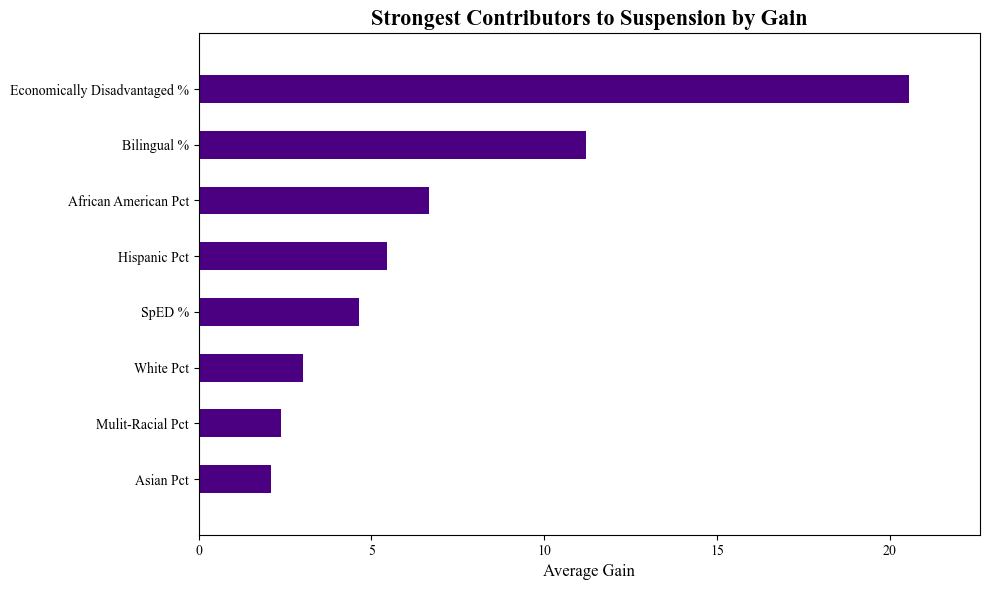

In [456]:
from xgboost import plot_importance
susp_xgb_clf = XGBClassifier(
    n_estimators=150,
    learning_rate=0.005,
    max_depth=3,
    eval_metric='logloss',
    random_state=42,
    colsample_bytree=1.0,
    subsample=0.8
)

susp_xgb_clf.fit(X, y)
fig, ax = plt.subplots(figsize=(10, 6))


plot_importance(
    susp_xgb_clf,
    importance_type='gain',
    max_num_features=15,
    height=0.5,
    color='indigo',
    ax=ax
)

#plot aesthetics
ax.set_title("Strongest Contributors to Suspension by Gain", fontsize=16, weight='bold')
ax.set_xlabel("Average Gain", fontsize=12)
ax.set_ylabel("")  # optional: remove ylabel text

ax.grid(False)

ax.tick_params(axis='both', labelsize=10)

for txt in ax.texts:
    txt.set_visible(False)

plt.tight_layout()
plt.rcParams['font.family'] = 'Times New Roman'
plt.show()




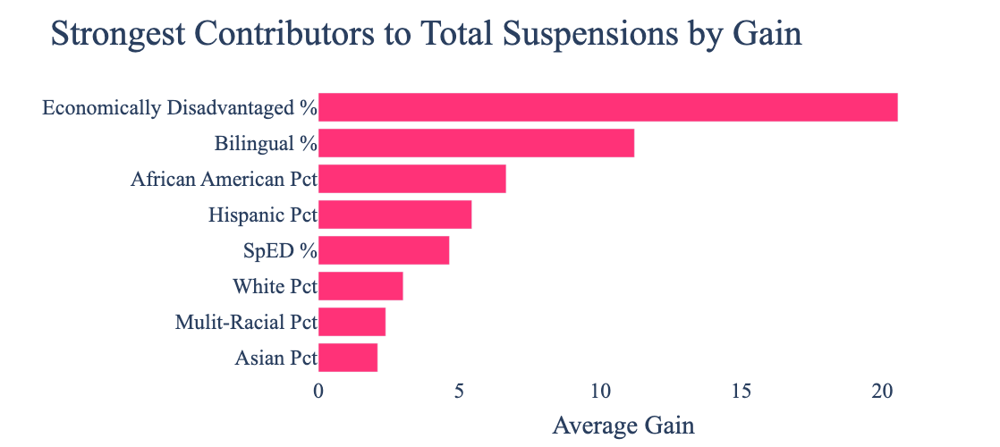

In [457]:
import pandas as pd
import plotly.express as px

# Get top 15 features by gain from XGBoost
importance_dict = susp_xgb_clf.get_booster().get_score(importance_type='gain')
importance_series = pd.Series(importance_dict).sort_values(ascending=False).head(15)

# Put into a DataFrame for Plotly
df_importance = pd.DataFrame({
    'Feature': importance_series.index,
    'Gain': importance_series.values
}).sort_values(by='Gain', ascending=True)  # ascending for bottom-up bar chart


fig = px.bar(
    df_importance,
    x='Gain',
    y='Feature',
    orientation='h',
    color_discrete_sequence=['rgb(255,50,120)'],  # solid color for all bars
    title='Strongest Contributors to Total Suspensions by Gain'
)

# Customize layout
fig.update_layout(
    font_family='Times New Roman',
    font_size=24,
    title_font_size=40,
    xaxis_title='Average Gain',
    yaxis_title='',
    plot_bgcolor='white',
    height=500
)

fig.show()




In [252]:
!pip install xgboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 8.0 MB/s eta 0:00:00a 0:00:01


In [ ]:
#now lets do the same process, but for the excessive suspenders

In [473]:
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import uniform, randint
from sklearn.metrics import f1_score
import numpy as np

features = features = [
    'Bilingual %', 'SpED %', 'Economically Disadvantaged %',
    'White Pct', 'African American Pct', 'Asian Pct', 'Hispanic Pct',
    'Mulit-Racial Pct', 'Predom AfAm',
]

X = scale_df[features]
y = scale_df["Excessive"]
neg = (y == 0).sum()
pos = (y == 1).sum()
scale = neg / pos


xgb_clf = XGBClassifier(
    objective='binary:logistic',
    eval_metric='logloss',
    random_state=42,
    scale_pos_weight=scale #to make the model more conscious about false negatives
)


param_grid = {
    'n_estimators': [50, 100, 150],
    'max_depth': [3, 4, 5, 6],
    'learning_rate': [0.05, 0.1, 0.2, 0.3],
    'subsample': [0.7, 0.8, 1.0],
    'colsample_bytree': [0.7, 0.8, 1.0]
}

grid_cv = GridSearchCV(
    estimator=xgb_clf,
    param_grid=param_grid,
    scoring='f1',
    cv=5,
    verbose=1,
    n_jobs=-1
)

grid_cv.fit(X, y)

print("Best parameters:", grid_cv.best_params_)
print("Best score:", grid_cv.best_score_)


Fitting 5 folds for each of 432 candidates, totalling 2160 fits
Best parameters: {'colsample_bytree': 1.0, 'learning_rate': 0.2, 'max_depth': 5, 'n_estimators': 150, 'subsample': 0.8}
Best score: 0.6187123583079093


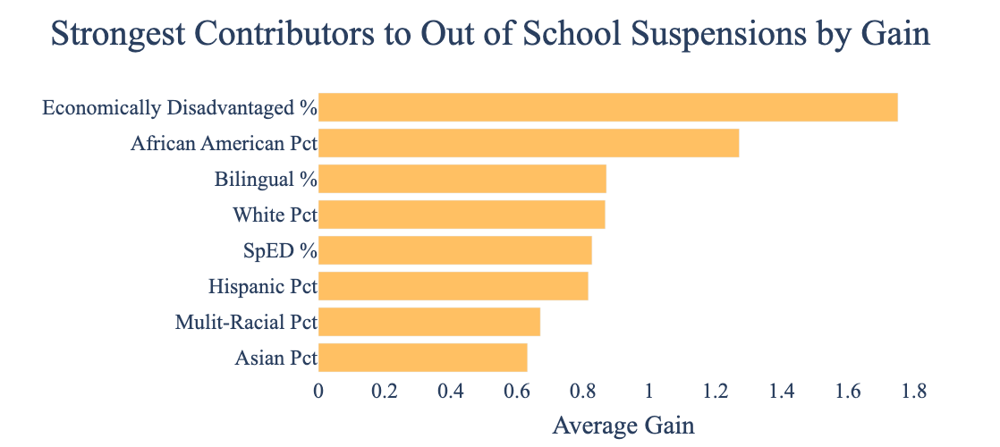

In [478]:
oss_xgb_clf = XGBClassifier(
    n_estimators=150,
    learning_rate=0.2,
    max_depth=5,
    eval_metric='logloss',
    random_state=42,
    colsample_bytree=1.0,
    subsample=0.8
)

oss_xgb_clf.fit(X, y)

#getting gain features
importance_dict = oss_xgb_clf.get_booster().get_score(importance_type='gain')
importance_series = pd.Series(importance_dict).sort_values(ascending=False).head(15)


df_importance = pd.DataFrame({
    'Feature': importance_series.index,
    'Gain': importance_series.values
}).sort_values(by='Gain', ascending=True)  # ascending for bottom-up bar chart

fig = px.bar(
    df_importance,
    x='Gain',
    y='Feature',
    orientation='h',
    color_discrete_sequence=['rgb(255,192,99)'],  # solid color for all bars
    title='Strongest Contributors to Out of School Suspensions by Gain'
)

# Customize layout
fig.update_layout(
    font_family='Times New Roman',
    font_size=24,
    title_font_size=40,
    xaxis_title='Average Gain',
    yaxis_title='',
    plot_bgcolor='white',
    height=500
)



fig.show()


In [597]:
#adding police data
districts = pd.read_csv("police_district_profiles.csv")
districts

,dist_num,dist_name,num_youth,num_youth_black,pct_youth_black,num_youth_hispanic,pct_youth_hispanic,num_youth_white,pct_youth_white,num_arrests,num_arrests_black,pct_arrests_black,num_arrests_hispanic,pct_arrests_hispanic,num_arrests_white,pct_arrests_white
0,1,Central,1450,973,0.671034,66,0.045517,411,0.283448,416,367,0.865566,28,0.066038,21,0.049528
1,2,Wentworth,9489,8379,0.883022,366,0.038571,744,0.078407,890,874,0.977629,9,0.010067,7,0.007830
2,3,Grand Crossing,9064,8775,0.968116,148,0.016328,141,0.015556,1012,1011,0.998026,0,0.000000,1,0.000987
3,4,South Chicago,14692,8671,0.590185,5537,0.376872,484,0.032943,1333,1118,0.838081,200,0.149925,15,0.011244
4,5,Calumet,9303,8967,0.963883,243,0.026121,93,0.009997,1063,1048,0.984038,13,0.012207,2,0.001878
5,6,Gresham,11079,10965,0.989710,106,0.009568,8,0.000722,1025,1013,0.987329,8,0.007797,4,0.003899
6,7,Englewood,8926,8587,0.962021,316,0.035402,23,0.002577,994,985,0.987964,8,0.008024,1,0.001003
7,8,Chicago Lawn,33827,6450,0.190676,24329,0.719218,3048,0.090106,1597,927,0.580100,618,0.386733,52,0.032541
8,9,Deering,19433,2730,0.140483,15233,0.783873,1470,0.075645,925,439,0.474082,438,0.473002,48,0.051836
9,10,Ogden,15348,4594,0.299322,10655,0.694227,99,0.006450,1093,732,0.669716,352,0.322049,9,0.008234


In [598]:
#reading in police district shapefile. 
bounds = gpd.read_file("Police_District_Boundary_View.shx")
bounds.set_crs(epsg=3857, inplace=True) 
bounds = bounds.to_crs(epsg=4326)
bounds

,geometry
0,"POLYGON ((-87.63194 41.86016, -87.63117 41.860..."
1,"POLYGON ((-87.68604 41.86662, -87.68604 41.866..."
2,"POLYGON ((-87.6077 41.83859, -87.60618 41.8385..."
3,"POLYGON ((-87.71442 41.82862, -87.71433 41.826..."
4,"POLYGON ((-87.58002 41.79349, -87.5795 41.7935..."
5,"POLYGON ((-87.63077 41.7942, -87.63076 41.7941..."
6,"POLYGON ((-87.55547 41.76136, -87.55476 41.761..."
7,"POLYGON ((-87.59801 41.75866, -87.59778 41.758..."
8,"POLYGON ((-87.63632 41.73618, -87.63593 41.736..."
9,"POLYGON ((-87.58777 41.72231, -87.58762 41.722..."


In [599]:
bound_df = pd.read_csv("Police_District_Boundary_View.csv")
bound_df

,OBJECTID,DISTRICT,NAME,SHAPE__Area,SHAPE__Length
0,1,9,9th-district-deering,6.311257e+07,35622.061193
1,2,10,10th-district-ogden,3.674424e+07,28802.231012
2,3,2,2nd-district-wentworth,3.509267e+07,26791.430352
3,4,8,8th-district-chicago-lawn,1.077532e+08,53384.741306
4,5,3,3rd-district-grand-crossing,2.833540e+07,28901.009125
5,6,7,7th-district-englewood,3.036305e+07,22255.132017
6,7,4,4th-district-south-chicago,1.267973e+08,57946.564148
7,8,6,6th-district-gresham,3.771558e+07,29382.334004
8,10,22,22nd-district-morgan-park,6.262113e+07,48947.833461
9,11,5,5th-district-calumet,5.949936e+07,44806.725673


In [600]:
bounds = pd.concat([bounds, bound_df], axis=1)
bounds

,geometry,OBJECTID,DISTRICT,NAME,SHAPE__Area,SHAPE__Length
0,"POLYGON ((-87.63194 41.86016, -87.63117 41.860...",1,9,9th-district-deering,6.311257e+07,35622.061193
1,"POLYGON ((-87.68604 41.86662, -87.68604 41.866...",2,10,10th-district-ogden,3.674424e+07,28802.231012
2,"POLYGON ((-87.6077 41.83859, -87.60618 41.8385...",3,2,2nd-district-wentworth,3.509267e+07,26791.430352
3,"POLYGON ((-87.71442 41.82862, -87.71433 41.826...",4,8,8th-district-chicago-lawn,1.077532e+08,53384.741306
4,"POLYGON ((-87.58002 41.79349, -87.5795 41.7935...",5,3,3rd-district-grand-crossing,2.833540e+07,28901.009125
5,"POLYGON ((-87.63077 41.7942, -87.63076 41.7941...",6,7,7th-district-englewood,3.036305e+07,22255.132017
6,"POLYGON ((-87.55547 41.76136, -87.55476 41.761...",7,4,4th-district-south-chicago,1.267973e+08,57946.564148
7,"POLYGON ((-87.59801 41.75866, -87.59778 41.758...",8,6,6th-district-gresham,3.771558e+07,29382.334004
8,"POLYGON ((-87.63632 41.73618, -87.63593 41.736...",10,22,22nd-district-morgan-park,6.262113e+07,48947.833461
9,"POLYGON ((-87.58777 41.72231, -87.58762 41.722...",11,5,5th-district-calumet,5.949936e+07,44806.725673


In [601]:
districts = districts.rename(columns={"dist_num":"DISTRICT"})
districts

,DISTRICT,dist_name,num_youth,num_youth_black,pct_youth_black,num_youth_hispanic,pct_youth_hispanic,num_youth_white,pct_youth_white,num_arrests,num_arrests_black,pct_arrests_black,num_arrests_hispanic,pct_arrests_hispanic,num_arrests_white,pct_arrests_white
0,1,Central,1450,973,0.671034,66,0.045517,411,0.283448,416,367,0.865566,28,0.066038,21,0.049528
1,2,Wentworth,9489,8379,0.883022,366,0.038571,744,0.078407,890,874,0.977629,9,0.010067,7,0.007830
2,3,Grand Crossing,9064,8775,0.968116,148,0.016328,141,0.015556,1012,1011,0.998026,0,0.000000,1,0.000987
3,4,South Chicago,14692,8671,0.590185,5537,0.376872,484,0.032943,1333,1118,0.838081,200,0.149925,15,0.011244
4,5,Calumet,9303,8967,0.963883,243,0.026121,93,0.009997,1063,1048,0.984038,13,0.012207,2,0.001878
5,6,Gresham,11079,10965,0.989710,106,0.009568,8,0.000722,1025,1013,0.987329,8,0.007797,4,0.003899
6,7,Englewood,8926,8587,0.962021,316,0.035402,23,0.002577,994,985,0.987964,8,0.008024,1,0.001003
7,8,Chicago Lawn,33827,6450,0.190676,24329,0.719218,3048,0.090106,1597,927,0.580100,618,0.386733,52,0.032541
8,9,Deering,19433,2730,0.140483,15233,0.783873,1470,0.075645,925,439,0.474082,438,0.473002,48,0.051836
9,10,Ogden,15348,4594,0.299322,10655,0.694227,99,0.006450,1093,732,0.669716,352,0.322049,9,0.008234


In [602]:
bounds_merged = bounds.merge(districts, on="DISTRICT", how="inner")
bounds_merged

,geometry,OBJECTID,DISTRICT,NAME,SHAPE__Area,SHAPE__Length,dist_name,num_youth,num_youth_black,pct_youth_black,...,pct_youth_hispanic,num_youth_white,pct_youth_white,num_arrests,num_arrests_black,pct_arrests_black,num_arrests_hispanic,pct_arrests_hispanic,num_arrests_white,pct_arrests_white
0,"POLYGON ((-87.63194 41.86016, -87.63117 41.860...",1,9,9th-district-deering,6.311257e+07,35622.061193,Deering,19433,2730,0.140483,...,0.783873,1470,0.075645,925,439,0.474082,438,0.473002,48,0.051836
1,"POLYGON ((-87.68604 41.86662, -87.68604 41.866...",2,10,10th-district-ogden,3.674424e+07,28802.231012,Ogden,15348,4594,0.299322,...,0.694227,99,0.006450,1093,732,0.669716,352,0.322049,9,0.008234
2,"POLYGON ((-87.6077 41.83859, -87.60618 41.8385...",3,2,2nd-district-wentworth,3.509267e+07,26791.430352,Wentworth,9489,8379,0.883022,...,0.038571,744,0.078407,890,874,0.977629,9,0.010067,7,0.007830
3,"POLYGON ((-87.71442 41.82862, -87.71433 41.826...",4,8,8th-district-chicago-lawn,1.077532e+08,53384.741306,Chicago Lawn,33827,6450,0.190676,...,0.719218,3048,0.090106,1597,927,0.580100,618,0.386733,52,0.032541
4,"POLYGON ((-87.58002 41.79349, -87.5795 41.7935...",5,3,3rd-district-grand-crossing,2.833540e+07,28901.009125,Grand Crossing,9064,8775,0.968116,...,0.016328,141,0.015556,1012,1011,0.998026,0,0.000000,1,0.000987
5,"POLYGON ((-87.63077 41.7942, -87.63076 41.7941...",6,7,7th-district-englewood,3.036305e+07,22255.132017,Englewood,8926,8587,0.962021,...,0.035402,23,0.002577,994,985,0.987964,8,0.008024,1,0.001003
6,"POLYGON ((-87.55547 41.76136, -87.55476 41.761...",7,4,4th-district-south-chicago,1.267973e+08,57946.564148,South Chicago,14692,8671,0.590185,...,0.376872,484,0.032943,1333,1118,0.838081,200,0.149925,15,0.011244
7,"POLYGON ((-87.59801 41.75866, -87.59778 41.758...",8,6,6th-district-gresham,3.771558e+07,29382.334004,Gresham,11079,10965,0.989710,...,0.009568,8,0.000722,1025,1013,0.987329,8,0.007797,4,0.003899
8,"POLYGON ((-87.63632 41.73618, -87.63593 41.736...",10,22,22nd-district-morgan-park,6.262113e+07,48947.833461,Morgan Park,11044,6720,0.608475,...,0.052970,3739,0.338555,682,655,0.960411,1,0.001466,26,0.038123
9,"POLYGON ((-87.58777 41.72231, -87.58762 41.722...",11,5,5th-district-calumet,5.949936e+07,44806.725673,Calumet,9303,8967,0.963883,...,0.026121,93,0.009997,1063,1048,0.984038,13,0.012207,2,0.001878


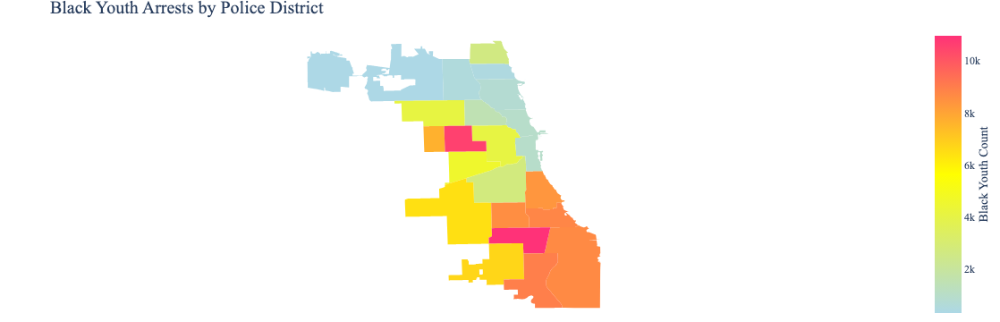

In [610]:
#mapping Black police arrests by district
geojson = json.loads(bounds_merged.to_json())


fig = px.choropleth(
    scaled_bounds,
    geojson=geojson,
    locations="DISTRICT",
    featureidkey="properties.DISTRICT",
    color="num_youth_black",
    color_continuous_scale=[
        "rgb(173,216,230)",  # light blue
        "yellow",
        "rgb(255,50,120)"    # red
    ],
    labels={"num_youth_black": "Number of Youth"},
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title_text="Black Youth Arrests by Police District",
    title_font=dict(size=20, family="Times New Roman"),
    margin={"r": 0, "t": 30, "l": 0, "b": 0},
    coloraxis_colorbar=dict(
        title=dict(text="Black Youth Count", font=dict(family="Times New Roman", size=14)),
        tickfont=dict(family="Times New Roman", size=12)
    )
)

fig.update_layout(
    coloraxis_colorbar=dict(
        title=dict(
            text='Black Youth Count',
            font=dict(family='Times New Roman', size=14),
            side='right'  # vertical label
        ),
        tickfont=dict(
            family='Times New Roman',
            size=12
        )
    )
)
fig.update_traces(marker_line_width=0)
fig.show()

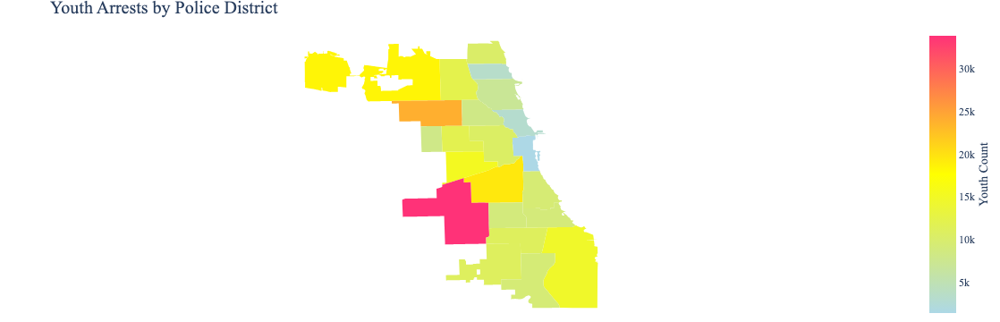

In [604]:
#Mapping total arrests by district 

fig = px.choropleth(
    bounds_merged,
    geojson=geojson,
    locations="DISTRICT",
    featureidkey="properties.DISTRICT",
    color="num_youth",
    color_continuous_scale=[
        "rgb(173,216,230)",
        "yellow",
        "rgb(255,50,120)"   
    ],
    labels={"num_youth": "Number of Youth"},
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title_text="Youth Arrests by Police District",
    title_font=dict(size=20, family="Times New Roman"),
    margin={"r": 0, "t": 30, "l": 0, "b": 0},
    coloraxis_colorbar=dict(
        title=dict(text="Youth Count", font=dict(family="Times New Roman", size=14)),
        tickfont=dict(family="Times New Roman", size=12)
    )
)
fig.update_layout(
    coloraxis_colorbar=dict(
        title=dict(
            text='Youth Count',
            font=dict(family='Times New Roman', size=14),
            side='right'
        ),
        tickfont=dict(
            family='Times New Roman',
            size=12
        )
    )
)
fig.update_traces(marker_line_width=0)
fig.show()

In [605]:
#This seems strange. This graph doesn't correlate with the others. 
#Oh yeah! It's not standardized. District 8 appears to have the most arrests, but what if it has the most people? 
#We need the arrests PER some amount of people.

In [606]:
bounds_merged.to_csv("bounds.csv", index=False)

In [607]:
#Found data on the population of each police district online, making a new data sheet with a scaled column for number of arrests per 10,000 people.

In [608]:
scaled_bounds = pd.read_csv("scaled_bounds - bounds.csv.csv")
scaled_bounds

,geometry,OBJECTID,DISTRICT,NAME,SHAPE__Area,SHAPE__Length,dist_name,num_youth,scaled_youth,num_youth_black,...,pct_youth_hispanic,num_youth_white,pct_youth_white,num_arrests,num_arrests_black,pct_arrests_black,num_arrests_hispanic,pct_arrests_hispanic,num_arrests_white,pct_arrests_white
0,POLYGON ((-87.63193986348723 41.86015584234176...,1,9,9th-district-deering,6.311257e+07,35622.06119,Deering,19433,1165.02,2730,...,0.783873,1470,0.075645,925,439,0.474082,438,0.473002,48,0.051836
1,POLYGON ((-87.68604417939517 41.86662039275859...,2,10,10th-district-ogden,3.674424e+07,28802.23101,Ogden,15348,1423.21,4594,...,0.694227,99,0.006450,1093,732,0.669716,352,0.322049,9,0.008234
2,NaN,3,2,2nd-district-wentworth,3.509267e+07,26791.43035,Wentworth,9489,900.67,8379,...,0.038571,744,0.078407,890,874,0.977629,9,0.010067,7,0.007830
3,POLYGON ((-87.71442164896656 41.82862181377176...,4,8,8th-district-chicago-lawn,1.077532e+08,53384.74131,Chicago Lawn,33827,1350.09,6450,...,0.719218,3048,0.090106,1597,927,0.580100,618,0.386733,52,0.032541
4,NaN,5,3,3rd-district-grand-crossing,2.833540e+07,28901.00913,Grand Crossing,9064,1160.70,8775,...,0.016328,141,0.015556,1012,1011,0.998026,0,0.000000,1,0.000987
5,POLYGON ((-87.63076524155483 41.79420401573793...,6,7,7th-district-englewood,3.036305e+07,22255.13202,Englewood,8926,1519.47,8587,...,0.035402,23,0.002577,994,985,0.987964,8,0.008024,1,0.001003
6,NaN,7,4,4th-district-south-chicago,1.267973e+08,57946.56415,South Chicago,14692,1265.58,8671,...,0.376872,484,0.032943,1333,1118,0.838081,200,0.149925,15,0.011244
7,POLYGON ((-87.59800644733087 41.75865998122463...,8,6,6th-district-gresham,3.771558e+07,29382.33400,Gresham,11079,1271.08,10965,...,0.009568,8,0.000722,1025,1013,0.987329,8,0.007797,4,0.003899
8,POLYGON ((-87.63632189370361 41.73618471679062...,10,22,22nd-district-morgan-park,6.262113e+07,48947.83346,Morgan Park,11044,1136.09,6720,...,0.052970,3739,0.338555,682,655,0.960411,1,0.001466,26,0.038123
9,"POLYGON ((-87.5877656440945 41.72231328179277,...",11,5,5th-district-calumet,5.949936e+07,44806.72567,Calumet,9303,1403.80,8967,...,0.026121,93,0.009997,1063,1048,0.984038,13,0.012207,2,0.001878


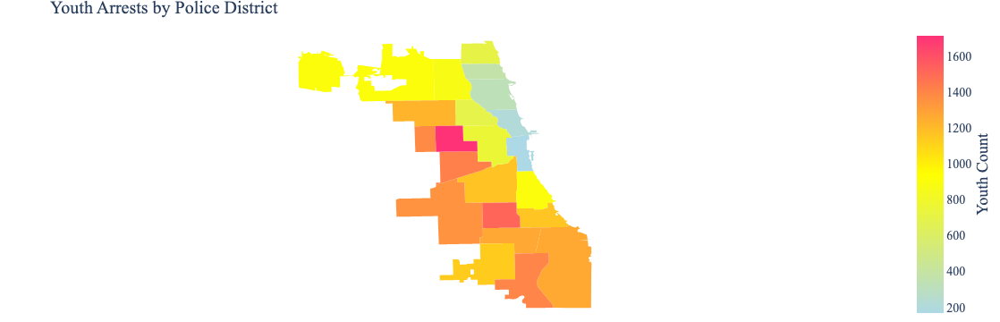

In [609]:
fig = px.choropleth(
    scaled_bounds,
    geojson=geojson,
    locations="DISTRICT",
    featureidkey="properties.DISTRICT",
    color="scaled_youth",
    color_continuous_scale=[
        "rgb(173,216,230)",
        "yellow",
        "rgb(255,50,120)"   
    ],
    labels={"scaled_youth": "Number of Youth"},
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title_text="Youth Arrests by Police District",
    title_font=dict(size=20, family="Times New Roman"),
    margin={"r": 0, "t": 30, "l": 0, "b": 0},
    coloraxis_colorbar=dict(
        title=dict(text="Youth Count", font=dict(family="Times New Roman", size=14)),
        tickfont=dict(family="Times New Roman", size=16)
    )
)
fig.update_layout(
    coloraxis_colorbar=dict(
        title=dict(
            text='Youth Count',
            font=dict(family='Times New Roman', size=18),
            side='right'
        ),
        tickfont=dict(
            family='Times New Roman',
            size=14
        )
    )
)
fig.update_traces(marker_line_width=0)
fig.show()

In [ ]:
#GEOGRAPHIC DATA ANALYSIS

In [519]:
network_avg = geo_full_df.groupby("NetworkNum")["% of Misconducts Resulting in an OSS"].mean().reset_index()
network_avg
plot_df = geo_full_df.drop_duplicates(subset="NetworkNum").drop(columns=["Average Length of OSS"])
plot_df = plot_df.merge(network_avg, on="NetworkNum", how="left")
plot_df

,PlanningZo,NetworkNum,the_geom,geometry,School ID,# of Misconducts,# of Group 1-2 Misconducts,# of Group 3-4 Misconducts,# of Group 5-6 Misconducts,# of Suspensions (includes ISS and OSS),...,Mulit-Racial No,Mulit-Racial Pct,Asian No,Asian Pct,Hawaiian/\nPacific Islander No,Hawaiian/\nPacific Islander Pct,Not \nAvailable No,Not \nAvailable Pct,Predom AfAm,% of Misconducts Resulting in an OSS_y
0,Far South Side - Far East Side,13,MULTIPOLYGON (((-87.52948021251774 41.73234267...,"MULTIPOLYGON (((-87.52948 41.73234, -87.52946 ...",609800,486,221,191,74,207,...,4.64,1.56,0.10,0.00,0.60,0.20,0.22,0.07,True,25.157692
1,Midway-Chgo Lawn-Ashburn-Beverly,10,MULTIPOLYGON (((-87.74295868650016 41.80032747...,"MULTIPOLYGON (((-87.74296 41.80033, -87.74295 ...",609788,1515,741,679,95,491,...,3.45,1.07,1.00,0.34,0.56,0.21,0.00,0.00,True,35.529167
2,Englewood-Auburn Gresham,11,MULTIPOLYGON (((-87.63157412008636 41.80181247...,"MULTIPOLYGON (((-87.63157 41.80181, -87.63157 ...",609790,1770,312,1287,171,1415,...,2.09,0.58,0.00,0.00,0.00,0.00,0.22,0.06,True,49.650000
3,Bronzeville-Hyde Park-Woodlawn,9,MULTIPOLYGON (((-87.60871811103908 41.84682690...,"MULTIPOLYGON (((-87.60872 41.84683, -87.60867 ...",609819,1139,260,665,214,584,...,2.09,0.52,0.00,0.00,0.11,0.02,0.44,0.10,True,43.438462
4,Pilsen-Little Village,7,MULTIPOLYGON (((-87.63899894964086 41.85955448...,"MULTIPOLYGON (((-87.639 41.85955, -87.63899 41...",609920,739,346,310,83,271,...,0.33,0.06,0.00,0.00,0.00,0.00,0.00,0.00,False,34.633333
5,McKinley Park,8,MULTIPOLYGON (((-87.66336061162971 41.83763552...,"MULTIPOLYGON (((-87.66336 41.83764, -87.66317 ...",609855,148,80,66,2,87,...,0.33,0.10,1.22,0.32,1.18,0.36,3.33,0.88,False,28.633333
6,Near N-Near W-Loop-BridgePort-Chinatown,6,MULTIPOLYGON (((-87.61010880186276 41.87412995...,"MULTIPOLYGON (((-87.61011 41.87413, -87.61472 ...",609777,145,45,89,11,99,...,4.73,1.52,13.09,4.82,0.20,0.03,0.00,0.00,False,31.535294
7,Humboldt Park-Garfield W-N Lawndale,5,MULTIPOLYGON (((-87.68731885819079 41.91415007...,"MULTIPOLYGON (((-87.68732 41.91415, -87.68732 ...",609797,518,187,282,49,243,...,0.67,0.13,0.00,0.00,0.00,0.00,0.00,0.00,True,47.095238
8,Saug-ReedDunning-AlbanyPk,1,MULTIPOLYGON (((-87.80655165600717 42.01871833...,"MULTIPOLYGON (((-87.80655 42.01872, -87.80655 ...",609792,928,452,408,68,390,...,14.18,1.21,36.36,3.63,2.36,0.24,26.00,2.51,False,21.327586
9,Belmont-Austin,3,MULTIPOLYGON (((-87.74137265178526 41.90922505...,"MULTIPOLYGON (((-87.74137 41.90923, -87.74137 ...",609818,409,105,190,114,213,...,1.55,0.16,3.36,0.36,1.11,0.11,4.56,0.51,False,45.464706


In [ ]:
#we once again alter the police district df. this time so that the boundaries map to school networks

In [523]:
plot_df.to_csv("networks.csv", index=False)

In [527]:
new_bounds = scaled_bounds.copy()
new_bounds

,geometry,OBJECTID,DISTRICT,NAME,SHAPE__Area,SHAPE__Length,dist_name,num_youth,scaled_youth,num_youth_black,...,pct_youth_hispanic,num_youth_white,pct_youth_white,num_arrests,num_arrests_black,pct_arrests_black,num_arrests_hispanic,pct_arrests_hispanic,num_arrests_white,pct_arrests_white
0,POLYGON ((-87.63193986348723 41.86015584234176...,1,9,9th-district-deering,6.311257e+07,35622.06119,Deering,19433,1165.02,2730,...,0.783873,1470,0.075645,925,439,0.474082,438,0.473002,48,0.051836
1,POLYGON ((-87.68604417939517 41.86662039275859...,2,10,10th-district-ogden,3.674424e+07,28802.23101,Ogden,15348,1423.21,4594,...,0.694227,99,0.006450,1093,732,0.669716,352,0.322049,9,0.008234
2,NaN,3,2,2nd-district-wentworth,3.509267e+07,26791.43035,Wentworth,9489,900.67,8379,...,0.038571,744,0.078407,890,874,0.977629,9,0.010067,7,0.007830
3,POLYGON ((-87.71442164896656 41.82862181377176...,4,8,8th-district-chicago-lawn,1.077532e+08,53384.74131,Chicago Lawn,33827,1350.09,6450,...,0.719218,3048,0.090106,1597,927,0.580100,618,0.386733,52,0.032541
4,NaN,5,3,3rd-district-grand-crossing,2.833540e+07,28901.00913,Grand Crossing,9064,1160.70,8775,...,0.016328,141,0.015556,1012,1011,0.998026,0,0.000000,1,0.000987
5,POLYGON ((-87.63076524155483 41.79420401573793...,6,7,7th-district-englewood,3.036305e+07,22255.13202,Englewood,8926,1519.47,8587,...,0.035402,23,0.002577,994,985,0.987964,8,0.008024,1,0.001003
6,NaN,7,4,4th-district-south-chicago,1.267973e+08,57946.56415,South Chicago,14692,1265.58,8671,...,0.376872,484,0.032943,1333,1118,0.838081,200,0.149925,15,0.011244
7,POLYGON ((-87.59800644733087 41.75865998122463...,8,6,6th-district-gresham,3.771558e+07,29382.33400,Gresham,11079,1271.08,10965,...,0.009568,8,0.000722,1025,1013,0.987329,8,0.007797,4,0.003899
8,POLYGON ((-87.63632189370361 41.73618471679062...,10,22,22nd-district-morgan-park,6.262113e+07,48947.83346,Morgan Park,11044,1136.09,6720,...,0.052970,3739,0.338555,682,655,0.960411,1,0.001466,26,0.038123
9,"POLYGON ((-87.5877656440945 41.72231328179277,...",11,5,5th-district-calumet,5.949936e+07,44806.72567,Calumet,9303,1403.80,8967,...,0.026121,93,0.009997,1063,1048,0.984038,13,0.012207,2,0.001878


In [530]:
plot_df.columns


Index(['PlanningZo', 'NetworkNum', 'the_geom', 'geometry', 'School ID',
       '# of Misconducts', '# of Group 1-2 Misconducts',
       '# of Group 3-4 Misconducts', '# of Group 5-6 Misconducts',
       '# of Suspensions (includes ISS and OSS)',
       '% of Misconducts Resulting in a Suspension\n(includes ISS and OSS)',
       '# of ISS', '% of Misconducts Resulting in an ISS',
       '# of Unique Students Receiving ISS',
       '% of Unique Students Receiving ISS', 'Average Length of ISS',
       '# of OSS', '% of Misconducts Resulting in an OSS_x',
       '# of Unique Students Receiving OSS',
       '% of Unique Students Receiving OSS', '# of Police Notifications',
       '% of Misconducts Resulting in a Police Notification',
       '# of Unique Students Receiving Police Notification',
       '% of Unique Students Receiving Police Notification', 'School Name',
       'Total_x', 'Bilingual N', 'Bilingual %', 'SpED N', 'SpED %',
       'Economically Disadvantaged N', 'Economically Dis

In [531]:
def aggregate_districts_to_networks(districts_gdf, networks_gdf, value_col):
    """
    Aggregate police district data to school network boundaries
    using area-weighted interpolation
    """
    from tobler import area_weighted
    
    # This will distribute district values to networks based on area overlap
    aggregated = area_weighted.area_interpolate(
        source_df=new_bounds,
        target_df=plot_df, 
        extensive_variables=["scaled_youth",]
    )
    return aggregated

In [538]:
!pip install libpysal
!pip install esda
!pip install tobler

python(32971) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


python(32976) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


python(32978) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.7/18.7 MB 13.5 MB/s eta 0:00:00a 0:00:01


In [590]:
from libpysal.weights import Queen, Rook
from esda import Moran, Moran_BV
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from sklearn.preprocessing import StandardScaler
import warnings
warnings.filterwarnings('ignore')


#function to map school networks to police districts
def prepare_data_for_bivariate_moran(districts_gdf, networks_gdf, 
                                   arrests_col='scaled_youth', 
                                   suspensions_col='% of Unique Students Receiving OSS'):
 
    from tobler import area_weighted
    
    print("Aggregating police districts to school networks...")
    
    # Aggregate arrests from districts to networks using area-weighted interpolation
    networks_with_arrests = area_weighted.area_interpolate(
        source_df=districts_gdf,
        target_df=networks_gdf,
        extensive_variables=[arrests_col] 
    )
    
    networks_with_arrests[suspensions_col] = networks_gdf[suspensions_col]
    
    # Handle missing values
    networks_with_arrests[arrests_col] = networks_with_arrests[arrests_col].fillna(0)
    networks_with_arrests[suspensions_col] = networks_with_arrests[suspensions_col].fillna(0)
    scaler = StandardScaler()
    networks_with_arrests[[arrests_col, suspensions_col]] = scaler.fit_transform(networks_with_arrests[[arrests_col, suspensions_col]])
    print(networks_with_arrests)
    return networks_with_arrests
    

#creating spatial weight from combined geography
def create_spatial_weights(gdf, weight_type='queen'):
    
    if weight_type.lower() == 'queen':
        w = Queen.from_dataframe(gdf)
    else:
        w = Rook.from_dataframe(gdf)
    
    # Row-standardize the weights
    w.transform = 'r'
    
    print(f"Spatial weights created: {w.n} observations, {w.s0} total weights")
    print(f"Average neighbors per unit: {w.s0/w.n:.2f}")
    
    return w

#using Moran_BV class to conduct bivariate_morans_analysis on the data
def bivariate_morans_analysis(gdf, var1_col, var2_col, weights):

    
    # Extract the variables
    var1 = gdf[var1_col].values
    var2 = gdf[var2_col].values
    
    # Calculate bivariate Moran's I
    bv_moran = Moran_BV(var1, var2, weights)
    
    print("="*60)
    print("BIVARIATE MORAN'S I RESULTS & SIGNIFICANCE TESTS")
    print("="*60)
    print(f"Variable 1: {var1_col}")
    print(f"Variable 2: {var2_col}")
    print(f"Sample size: {len(var1)} spatial units")
    print()
    
    print("SPATIAL AUTOCORRELATION STATISTICS:")
    print(f"Bivariate Moran's I: {bv_moran.I:.6f}")
    print(f"Expected I (null): {bv_moran.EI_sim:.6f}")
    print(f"Variance: {bv_moran.VI_sim:.8f}")
    print(f"Standard deviation: {np.sqrt(bv_moran.VI_sim):.6f}")
    print()
    
    print("SIGNIFICANCE TESTS:")
    print(f"Z-score (normality assumption): {bv_moran.z_sim:.4f}")
    print(f"P-value (normal approximation): {bv_moran.p_sim:.6f}")
    print(f"P-value (permutation test): {bv_moran.p_sim:.6f}")
    
    # Multiple significance levels
    significance_levels = [0.001, 0.01, 0.05, 0.10]
    print(f"\nSIGNIFICANCE AT DIFFERENT ALPHA LEVELS:")
    for alpha in significance_levels:
        is_sig_normal = "✓" if bv_moran.p_sim < alpha else "✗"
        is_sig_perm = "✓" if bv_moran.p_sim < alpha else "✗"
        print(f"α = {alpha}: Normal {is_sig_normal} | Permutation {is_sig_perm}")
    
    # Effect size interpretation
    print(f"\nEFFECT SIZE INTERPRETATION:")
    abs_I = abs(bv_moran.I)
    if abs_I < 0.1:
        effect_size = "Very weak"
    elif abs_I < 0.3:
        effect_size = "Weak"
    elif abs_I < 0.5:
        effect_size = "Moderate" 
    elif abs_I < 0.7:
        effect_size = "Strong"
    else:
        effect_size = "Very strong"
    
    direction = "positive" if bv_moran.I > 0 else "negative"
    print(f"Effect size: {effect_size} {direction} spatial correlation")
    
    # Final interpretation
    print(f"\nINTERPRETATION:")
    if bv_moran.p_sim < 0.05:  # Use permutation test as it's more robust
        if bv_moran.I > 0:
            interpretation = f"SIGNIFICANT positive spatial correlation (p = {bv_moran.p_sim:.4f})"
            meaning = "Areas with high arrests tend to be near areas with high suspensions"
        else:
            interpretation = f"SIGNIFICANT negative spatial correlation (p = {bv_moran.p_sim:.4f})"
            meaning = "Areas with high arrests tend to be near areas with low suspensions"
    else:
        interpretation = f"NO significant spatial correlation (p = {bv_moran.p_sim:.4f})"
        meaning = "No clear spatial relationship between arrests and suspensions"
    
    print(f"• {interpretation}")
    print(f"• {meaning}")
    print("="*60)
    
def additional_significance_tests(gdf, var1_col, var2_col, weights):
    """
    Additional statistical tests for robustness
    """
    print("\n" + "="*60)
    print("ADDITIONAL SIGNIFICANCE & ROBUSTNESS TESTS")
    print("="*60)
    
    var1 = gdf[var1_col].values
    var2 = gdf[var2_col].values
    
    # 1. Pearson correlation (non-spatial)
    from scipy.stats import pearsonr, spearmanr
    pearson_r, pearson_p = pearsonr(var1, var2)
    spearman_r, spearman_p = spearmanr(var1, var2)
    
    print("NON-SPATIAL CORRELATIONS (for comparison):")
    print(f"Pearson correlation: r = {pearson_r:.4f}, p = {pearson_p:.4f}")
    print(f"Spearman correlation: ρ = {spearman_r:.4f}, p = {spearman_p:.4f}")
    
    # 2. Univariate Moran's I for each variable
    from esda import Moran
    moran_var1 = Moran(var1, weights)
    moran_var2 = Moran(var2, weights)
    
    print(f"\nUNIVARIATE SPATIAL AUTOCORRELATION:")
    print(f"{var1_col} - Moran's I: {moran_var1.I:.4f}, p = {moran_var1.p_sim:.4f}")
    print(f"{var2_col} - Moran's I: {moran_var2.I:.4f}, p = {moran_var2.p_sim:.4f}")
    
    # 3. Moran's I with different permutations
    bv_moran_999 = Moran_BV(var1, var2, weights, permutations=999)
    bv_moran_9999 = Moran_BV(var1, var2, weights, permutations=9999)
    
    print(f"\nPERMUTATION TEST ROBUSTNESS:")
    print(f"999 permutations: p = {bv_moran_999.p_sim:.6f}")
    print(f"9999 permutations: p = {bv_moran_9999.p_sim:.6f}")
    
    # 4. Alternative weights matrix
    from libpysal.weights import Rook
    weights_rook = Rook.from_dataframe(gdf)
    weights_rook.transform = 'r'
    bv_moran_rook = Moran_BV(var1, var2, weights_rook)
    
    print(f"\nALTERNATIVE WEIGHTS MATRIX (Rook vs Queen):")
    print(f"Rook contiguity: I = {bv_moran_rook.I:.4f}, p = {bv_moran_rook.p_sim:.4f}")
    
    # 5. Confidence intervals
    z_critical = 1.96  # 95% CI
    margin_of_error = z_critical * np.sqrt(bv_moran_999.VI_sim)
    ci_lower = bv_moran_999.I - margin_of_error
    ci_upper = bv_moran_999.I + margin_of_error
    
    print(f"\n95% CONFIDENCE INTERVAL:")
    print(f"Bivariate Moran's I: [{ci_lower:.4f}, {ci_upper:.4f}]")
    
    # 6. Power analysis (rough estimate)
    effect_size = abs(bv_moran_999.I - bv_moran_999.EI_sim) / np.sqrt(bv_moran_999.VI_sim)
    print(f"\nEFFECT SIZE MEASURES:")
    print(f"Standardized effect size: {effect_size:.4f}")
    print(f"Cohen's conventions: Small=0.2, Medium=0.5, Large=0.8")
    
    return {
        'pearson_r': pearson_r, 'pearson_p': pearson_p,
        'spearman_r': spearman_r, 'spearman_p': spearman_p,
        'moran_var1': moran_var1, 'moran_var2': moran_var2,
        'bv_moran_robust': bv_moran_9999,
        'bv_moran_rook': bv_moran_rook,
        'confidence_interval': (ci_lower, ci_upper),
        'effect_size': effect_size
    }

def plot_bivariate_moran_scatterplot(gdf, var1_col, var2_col, weights, bv_moran):
    """
    Create Moran scatterplot for bivariate analysis
    """
    
    # Standardize variables
    var1_std = (gdf[var1_col] - gdf[var1_col].mean()) / gdf[var1_col].std()
    var2_std = (gdf[var2_col] - gdf[var2_col].mean()) / gdf[var2_col].std()
    
    # Calculate spatial lag of var2
    var2_lag = weights.sparse.dot(var2_std)
    
    # Create the plot
    fig, ax = plt.subplots(1, 1, figsize=(10, 8))
    
    # Scatter plot
    ax.scatter(var1_std, var2_lag, alpha=0.7, s=50)
    
    # Add regression line
    slope, intercept, r_value, p_value, std_err = stats.linregress(var1_std, var2_lag)
    line = slope * var1_std + intercept
    ax.plot(var1_std, line, 'r--', alpha=0.8, linewidth=2)
    
    # Add quadrant lines
    ax.axhline(0, color='black', linestyle='-', alpha=0.3)
    ax.axvline(0, color='black', linestyle='-', alpha=0.3)
    
    # Labels and title
    ax.set_xlabel(f'Standardized {var1_col}', fontsize=12)
    ax.set_ylabel(f'Spatial Lag of Standardized {var2_col}', fontsize=12)
    ax.set_title(f'Bivariate Moran Scatterplot\nI = {bv_moran.I:.4f}, p = {bv_moran.p_norm:.4f}', 
                fontsize=14)
    
    # Add quadrant labels
    ax.text(0.02, 0.98, 'HH', transform=ax.transAxes, fontsize=12, 
            verticalalignment='top', bbox=dict(boxstyle='round', facecolor='lightblue'))
    ax.text(0.98, 0.98, 'LH', transform=ax.transAxes, fontsize=12, 
            verticalalignment='top', horizontalalignment='right',
            bbox=dict(boxstyle='round', facecolor='lightgreen'))
    ax.text(0.02, 0.02, 'LL', transform=ax.transAxes, fontsize=12, 
            bbox=dict(boxstyle='round', facecolor='lightyellow'))
    ax.text(0.98, 0.02, 'HL', transform=ax.transAxes, fontsize=12, 
            horizontalalignment='right',
            bbox=dict(boxstyle='round', facecolor='lightcoral'))
    
    plt.tight_layout()
    plt.show()
    
    return fig

def plot_correlation_map(gdf, var1_col, var2_col):
    """
    Create side-by-side maps of both variables
    """
    
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    
    # Plot arrests
    gdf.plot(column=var1_col, ax=axes[0], legend=True, 
             cmap='Reds', edgecolor='black', linewidth=0.5)
    axes[0].set_title(f'{var1_col.replace("_", " ").title()}')
    axes[0].set_axis_off()
    
    # Plot suspensions
    gdf.plot(column=var2_col, ax=axes[1], legend=True, 
             cmap='Blues', edgecolor='black', linewidth=0.5)
    axes[1].set_title(f'{var2_col.replace("_", " ").title()}')
    axes[1].set_axis_off()
    
    plt.tight_layout()
    plt.show()
    
    return fig

# MAIN ANALYSIS WORKFLOW
def run_bivariate_moran_analysis(districts_gdf, networks_gdf, 
                                arrests_col='scaled_youth', 
                                suspensions_col='% of Unique Students Receiving OSS'):
    """
    Complete workflow for bivariate Moran's I analysis with different spatial units
    """
    
    print("Step 1: Preparing data (aggregating districts to networks)...")
    combined_gdf = prepare_data_for_bivariate_moran(districts_gdf, networks_gdf, 
                                                  arrests_col, suspensions_col)
    
    print("Step 2: Creating spatial weights...")
    weights = create_spatial_weights(combined_gdf, weight_type='queen')
    
    print("Step 3: Running bivariate Moran's I...")
    bv_moran = bivariate_morans_analysis(combined_gdf, arrests_col, suspensions_col, weights)
    
    print("Step 3b: Additional significance tests...")
    additional_stats = additional_significance_tests(combined_gdf, arrests_col, suspensions_col, weights)
    

    return combined_gdf, weights, bv_moran


In [567]:

scaled_bounds = scaled_bounds.dropna()

scaled_bounds['geometry'] = scaled_bounds['geometry'].apply(wkt.loads)

scaled_bounds_gdf = gpd.GeoDataFrame(scaled_bounds, geometry='geometry')


scaled_bounds_gdf

TypeError: Expected bytes or string, got Polygon

In [568]:
scaled_bounds_gdf.set_crs("EPSG:4326", inplace=True)

,geometry,OBJECTID,DISTRICT,NAME,SHAPE__Area,SHAPE__Length,dist_name,num_youth,scaled_youth,num_youth_black,...,pct_youth_hispanic,num_youth_white,pct_youth_white,num_arrests,num_arrests_black,pct_arrests_black,num_arrests_hispanic,pct_arrests_hispanic,num_arrests_white,pct_arrests_white
0,"POLYGON ((-87.63194 41.86016, -87.63117 41.860...",1,9,9th-district-deering,6.311257e+07,35622.06119,Deering,19433,1165.02,2730,...,0.783873,1470,0.075645,925,439,0.474082,438,0.473002,48,0.051836
1,"POLYGON ((-87.68604 41.86662, -87.68604 41.866...",2,10,10th-district-ogden,3.674424e+07,28802.23101,Ogden,15348,1423.21,4594,...,0.694227,99,0.006450,1093,732,0.669716,352,0.322049,9,0.008234
3,"POLYGON ((-87.71442 41.82862, -87.71433 41.826...",4,8,8th-district-chicago-lawn,1.077532e+08,53384.74131,Chicago Lawn,33827,1350.09,6450,...,0.719218,3048,0.090106,1597,927,0.580100,618,0.386733,52,0.032541
5,"POLYGON ((-87.63077 41.7942, -87.63076 41.7941...",6,7,7th-district-englewood,3.036305e+07,22255.13202,Englewood,8926,1519.47,8587,...,0.035402,23,0.002577,994,985,0.987964,8,0.008024,1,0.001003
7,"POLYGON ((-87.59801 41.75866, -87.59778 41.758...",8,6,6th-district-gresham,3.771558e+07,29382.33400,Gresham,11079,1271.08,10965,...,0.009568,8,0.000722,1025,1013,0.987329,8,0.007797,4,0.003899
8,"POLYGON ((-87.63632 41.73618, -87.63593 41.736...",10,22,22nd-district-morgan-park,6.262113e+07,48947.83346,Morgan Park,11044,1136.09,6720,...,0.052970,3739,0.338555,682,655,0.960411,1,0.001466,26,0.038123
9,"POLYGON ((-87.58777 41.72231, -87.58762 41.722...",11,5,5th-district-calumet,5.949936e+07,44806.72567,Calumet,9303,1403.80,8967,...,0.026121,93,0.009997,1063,1048,0.984038,13,0.012207,2,0.001878
10,"POLYGON ((-87.67425 42.02301, -87.66542 42.022...",12,24,24th-district-rogers-park,2.546420e+07,22801.56238,Rogers Park,10322,706.46,2635,...,0.386456,3698,0.358264,320,230,0.707692,72,0.221538,18,0.055385
13,"POLYGON ((-87.6603 41.99092, -87.6603 41.9908,...",15,20,20th-district-lincoln,2.048740e+07,20128.41706,Lincoln,3427,373.31,458,...,0.444996,1444,0.421360,195,103,0.520202,66,0.333333,26,0.131313
15,"POLYGON ((-87.7174 41.93922, -87.7174 41.9391,...",19,25,25th-district-grand-central,5.108147e+07,32955.09228,Grand Central,23940,1224.73,4113,...,0.786675,994,0.041520,711,322,0.452883,366,0.514768,23,0.032349


In [591]:
run_bivariate_moran_analysis(scaled_bounds_gdf, plot_df, arrests_col='scaled_youth', suspensions_col='% of Unique Students Receiving OSS')

Step 1: Preparing data (aggregating districts to networks)...
Aggregating police districts to school networks...
    scaled_youth                                           geometry  \
0       0.234548  MULTIPOLYGON (((-87.52948 41.73234, -87.52946 ...   
1       0.637888  MULTIPOLYGON (((-87.74296 41.80033, -87.74295 ...   
2       1.628841  MULTIPOLYGON (((-87.63157 41.80181, -87.63157 ...   
3      -1.475286  MULTIPOLYGON (((-87.60872 41.84683, -87.60867 ...   
4      -0.160821  MULTIPOLYGON (((-87.639 41.85955, -87.63899 41...   
5      -0.293662  MULTIPOLYGON (((-87.66336 41.83764, -87.66317 ...   
6      -0.144272  MULTIPOLYGON (((-87.61011 41.87413, -87.61472 ...   
7       1.371201  MULTIPOLYGON (((-87.68732 41.91415, -87.68732 ...   
8      -1.522177  MULTIPOLYGON (((-87.80655 42.01872, -87.80655 ...   
9       1.461979  MULTIPOLYGON (((-87.74137 41.90923, -87.74137 ...   
10     -0.862684  MULTIPOLYGON (((-87.64098 41.95466, -87.64095 ...   
11     -0.199597  MULTIPOLYGON (((-

(    scaled_youth                                           geometry  \
 0       0.234548  MULTIPOLYGON (((-87.52948 41.73234, -87.52946 ...   
 1       0.637888  MULTIPOLYGON (((-87.74296 41.80033, -87.74295 ...   
 2       1.628841  MULTIPOLYGON (((-87.63157 41.80181, -87.63157 ...   
 3      -1.475286  MULTIPOLYGON (((-87.60872 41.84683, -87.60867 ...   
 4      -0.160821  MULTIPOLYGON (((-87.639 41.85955, -87.63899 41...   
 5      -0.293662  MULTIPOLYGON (((-87.66336 41.83764, -87.66317 ...   
 6      -0.144272  MULTIPOLYGON (((-87.61011 41.87413, -87.61472 ...   
 7       1.371201  MULTIPOLYGON (((-87.68732 41.91415, -87.68732 ...   
 8      -1.522177  MULTIPOLYGON (((-87.80655 42.01872, -87.80655 ...   
 9       1.461979  MULTIPOLYGON (((-87.74137 41.90923, -87.74137 ...   
 10     -0.862684  MULTIPOLYGON (((-87.64098 41.95466, -87.64095 ...   
 11     -0.199597  MULTIPOLYGON (((-87.66504 42.02249, -87.66494 ...   
 12     -0.675958  MULTIPOLYGON (((-87.62566 41.77491, -87.62552

In [542]:
type(scaled_bounds)

pandas.core.frame.DataFrame

In [570]:
scaled_bounds_gdf

,geometry,OBJECTID,DISTRICT,NAME,SHAPE__Area,SHAPE__Length,dist_name,num_youth,scaled_youth,num_youth_black,...,pct_youth_hispanic,num_youth_white,pct_youth_white,num_arrests,num_arrests_black,pct_arrests_black,num_arrests_hispanic,pct_arrests_hispanic,num_arrests_white,pct_arrests_white
0,"POLYGON ((-87.63194 41.86016, -87.63117 41.860...",1,9,9th-district-deering,6.311257e+07,35622.06119,Deering,19433,1165.02,2730,...,0.783873,1470,0.075645,925,439,0.474082,438,0.473002,48,0.051836
1,"POLYGON ((-87.68604 41.86662, -87.68604 41.866...",2,10,10th-district-ogden,3.674424e+07,28802.23101,Ogden,15348,1423.21,4594,...,0.694227,99,0.006450,1093,732,0.669716,352,0.322049,9,0.008234
3,"POLYGON ((-87.71442 41.82862, -87.71433 41.826...",4,8,8th-district-chicago-lawn,1.077532e+08,53384.74131,Chicago Lawn,33827,1350.09,6450,...,0.719218,3048,0.090106,1597,927,0.580100,618,0.386733,52,0.032541
5,"POLYGON ((-87.63077 41.7942, -87.63076 41.7941...",6,7,7th-district-englewood,3.036305e+07,22255.13202,Englewood,8926,1519.47,8587,...,0.035402,23,0.002577,994,985,0.987964,8,0.008024,1,0.001003
7,"POLYGON ((-87.59801 41.75866, -87.59778 41.758...",8,6,6th-district-gresham,3.771558e+07,29382.33400,Gresham,11079,1271.08,10965,...,0.009568,8,0.000722,1025,1013,0.987329,8,0.007797,4,0.003899
8,"POLYGON ((-87.63632 41.73618, -87.63593 41.736...",10,22,22nd-district-morgan-park,6.262113e+07,48947.83346,Morgan Park,11044,1136.09,6720,...,0.052970,3739,0.338555,682,655,0.960411,1,0.001466,26,0.038123
9,"POLYGON ((-87.58777 41.72231, -87.58762 41.722...",11,5,5th-district-calumet,5.949936e+07,44806.72567,Calumet,9303,1403.80,8967,...,0.026121,93,0.009997,1063,1048,0.984038,13,0.012207,2,0.001878
10,"POLYGON ((-87.67425 42.02301, -87.66542 42.022...",12,24,24th-district-rogers-park,2.546420e+07,22801.56238,Rogers Park,10322,706.46,2635,...,0.386456,3698,0.358264,320,230,0.707692,72,0.221538,18,0.055385
13,"POLYGON ((-87.6603 41.99092, -87.6603 41.9908,...",15,20,20th-district-lincoln,2.048740e+07,20128.41706,Lincoln,3427,373.31,458,...,0.444996,1444,0.421360,195,103,0.520202,66,0.333333,26,0.131313
15,"POLYGON ((-87.7174 41.93922, -87.7174 41.9391,...",19,25,25th-district-grand-central,5.108147e+07,32955.09228,Grand Central,23940,1224.73,4113,...,0.786675,994,0.041520,711,322,0.452883,366,0.514768,23,0.032349


In [623]:
import os
os.getcwd()

'/Users/yannickmofor/DataSci Final Proj'